# Dataset structure

In [1]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import h5py
import numpy as np
import torchvision.transforms as transforms # Assuming this is where your transforms are

# Define a default max pixel value if not passed.
# This should ideally match what your process_xray used as a multiplier.
DEFAULT_MAX_PIXEL_VALUE = 65535.0

class KneeMILDataset(Dataset):
    def __init__(self, h5_file_path, sample_group_names_list, transform=None,
                 kl_grade_mapping=None, max_pixel_value=DEFAULT_MAX_PIXEL_VALUE): # Added max_pixel_value
        """
        Args:
            h5_file_path (str): Path to the HDF5 file.
            sample_group_names_list (list): List of group names (e.g., "patient_001_L") for this dataset split.
            transform (callable, optional): Optional transform to be applied on a patch tensor [0,1] range.
            kl_grade_mapping (dict, optional): Mapping for KL grades.
            max_pixel_value (float, optional): The maximum possible pixel value in the raw patch data
                                               (e.g., 65535.0 if process_xray scaled to that).
                                               Used for scaling patches to [0,1].
        """
        self.h5_file_path = h5_file_path
        self.sample_group_names = sample_group_names_list
        self.transform = transform
        self.kl_grade_mapping = kl_grade_mapping
        self.max_pixel_value = float(max_pixel_value) # Ensure it's a float for division

    def __getitem__(self, idx):
        group_name = self.sample_group_names[idx]

        with h5py.File(self.h5_file_path, 'r') as hf:
            # Patches are loaded as np.float32, shape (N_patches, H, W, C), range [0, max_pixel_value]
            patches_data = hf[group_name]['patches'][:]
            kl_grade_val = hf[group_name]['kl_grade'][0]

            if self.kl_grade_mapping:
                kl_grade_val = self.kl_grade_mapping.get(kl_grade_val, kl_grade_val)

        processed_patches_list = [] # Use a different name to avoid confusion with 'patches_data'

        if patches_data.shape[0] == 0:
            print(f"Warning: Empty patches for {group_name} in __getitem__. Returning dummy data.")
            # Create a dummy tensor that matches expected output shape after transform
            # If transform is None, it's harder to know the exact final shape.
            # For now, let's assume C=1, H=16, W=16.
            # This dummy patch will also be [0,1] scaled.
            dummy_patch_tensor = torch.zeros((1, 16, 16), dtype=torch.float32)
            if self.transform:
                # The transform now expects a [0,1] tensor
                dummy_patch_tensor = self.transform(dummy_patch_tensor)
            # Return as a list of one dummy patch for collate_fn compatibility
            return [dummy_patch_tensor], torch.tensor(kl_grade_val, dtype=torch.long)

        for i in range(patches_data.shape[0]):
            patch_np = patches_data[i]  # Shape (H, W, C), np.float32, range [0, max_pixel_value]

            # 1. Scale to [0, 1.0]
            patch_np_scaled = patch_np / self.max_pixel_value
            # Ensure clipping if any minor floating point issues exceed 1.0, though unlikely with direct division
            patch_np_scaled = np.clip(patch_np_scaled, 0.0, 1.0)


            # 2. Transpose to (C, H, W) for PyTorch
            patch_np_transposed = np.transpose(patch_np_scaled, (2, 0, 1))

            # 3. Convert to PyTorch float tensor
            patch_tensor = torch.from_numpy(patch_np_transposed).float() # Already float, but good practice

            # 4. Apply transformations (which now expect a [0,1] float tensor)
            if self.transform:
                patch_tensor = self.transform(patch_tensor)

            processed_patches_list.append(patch_tensor)

        return processed_patches_list, torch.tensor(kl_grade_val, dtype=torch.long)

    def __len__(self):
        return len(self.sample_group_names)



def mil_collate_fn(batch):
    """
    Collate function for MIL where each sample has a variable number of patches.
    Args:
        batch: A list of tuples, where each tuple is (list_of_patch_tensors, label_tensor)
    Returns:
        A tuple (list_of_patch_bags, labels_batch_tensor)
        - list_of_patch_bags: A list where each element is a tensor of patches for a sample (N_i, C, H, W)
        - labels_batch_tensor: A tensor of labels (batch_size)
    """
    patch_bags = []
    labels = []

    for item_patches, item_label in batch:
        if not item_patches: # Handle case where a sample might have 0 patches after all
            print("Warning: mil_collate_fn encountered an empty patch list for a sample.")
            # Option 1: Skip this sample (might cause issues with batch size)
            # continue
            # Option 2: Create a dummy patch bag (e.g., one zero patch)
            # This depends on how the model handles it. For now, let's try to ensure non-empty.
            # This should be rare if Dataset filtering is good.
            # If we must proceed, a dummy tensor might be needed:
            # dummy_bag = torch.zeros((1, 1, TARGET_PATCH_SIZE[0], TARGET_PATCH_SIZE[1])) # N, C, H, W
            # patch_bags.append(dummy_bag)
            # labels.append(item_label)
            continue # Simplest for now: skip problematic samples if they slip through

        # Stack patches for the current sample into a single tensor (N_i, C, H, W)
        # item_patches is already a list of (C,H,W) tensors
        if isinstance(item_patches, list) and len(item_patches) > 0:
             current_bag = torch.stack(item_patches, dim=0)
             patch_bags.append(current_bag)
             labels.append(item_label)
        elif torch.is_tensor(item_patches) and item_patches.ndim == 4: # Already a stacked bag
             patch_bags.append(item_patches)
             labels.append(item_label)


    if not labels: # If all samples in batch were skipped
        return None, None # Or handle appropriately

    labels_batch_tensor = torch.stack(labels, dim=0)
    return patch_bags, labels_batch_tensor # patch_bags is a list of tensors

# Model

In [2]:
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models # For using pre-trained backbones

class PatchFeatureExtractor(nn.Module):
    def __init__(self, output_embedding_dim=128, num_channels=32, dropout_rate=0.4, adaptive_pool_output_size=(2, 2)):
        super().__init__()
        self.conv_block1 = nn.Sequential(
            nn.Conv2d(1, num_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels), # ADDED
            nn.ReLU(),
            nn.Conv2d(num_channels, num_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels), # ADDED
            nn.ReLU(),
            nn.Conv2d(num_channels, num_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels), # ADDED
            nn.ReLU(),
            nn.MaxPool2d(2, 2), # 16x16 -> 8x8
        )
        self.conv_block2 = nn.Sequential(
            nn.Conv2d(num_channels, num_channels*2, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels*2), # ADDED
            nn.ReLU(),
            nn.Conv2d(num_channels*2, num_channels*2, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels*2), # ADDED
            nn.ReLU(),
            nn.MaxPool2d(2, 2), # 8x8 -> 4x4
        )
        self.conv_block3 = nn.Sequential( # ADDED
            nn.Conv2d(num_channels*2, num_channels*4, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_channels * 4),
            nn.ReLU(),
            nn.MaxPool2d(2, 2) # 4x4 -> 2x2
        )

        self.flatten = nn.Flatten()
        self.dropout = nn.Dropout(p=dropout_rate)
        fc_input_size = (num_channels * 4) * 2 * 2 # Recalculate based on 2x2 output
        self.fc = nn.Linear(fc_input_size, output_embedding_dim)

    def forward(self, x_patch): # x_patch is (C, H, W)
        x = self.conv_block1(x_patch)
        x = self.conv_block2(x)
        x = self.conv_block3(x)
        x = self.flatten(x)
        embedding = self.fc(x)
        embedding = self.dropout(embedding)
        return embedding


class MILAggregator(nn.Module):
    def __init__(self, input_embedding_dim, num_classes, aggregation_type='attention', dropout_rate=0.4):
        super().__init__()
        self.input_embedding_dim = input_embedding_dim
        self.aggregation_type = aggregation_type
        self.num_classes = num_classes

        if self.aggregation_type == 'attention':
            # Attention mechanism (a simple version)
            self.attention_V = nn.Linear(input_embedding_dim, 128)
            self.attention_U = nn.Linear(input_embedding_dim, 128)
            self.attention_w = nn.Linear(128, 1) # Outputs one score per patch embedding
        elif self.aggregation_type not in ['mean', 'max']:
            raise ValueError("Unsupported aggregation type")

        self.dropout = nn.Dropout(p=dropout_rate) # ADDED
        self.classifier = nn.Linear(input_embedding_dim, num_classes)

    def forward(self, patch_embeddings_bag): # patch_embeddings_bag is (N_patches, embedding_dim)
        if patch_embeddings_bag.nelement() == 0: # Handle empty bag
            # Return zeros or some other placeholder prediction
            # This implies the bag itself might be problematic
            print("Warning: MILAggregator received an empty patch_embeddings_bag.")
            return torch.zeros((1, self.num_classes), device=patch_embeddings_bag.device)


        if self.aggregation_type == 'mean':
            aggregated_features = torch.mean(patch_embeddings_bag, dim=0) # (embedding_dim)
        elif self.aggregation_type == 'max':
            aggregated_features, _ = torch.max(patch_embeddings_bag, dim=0) # (embedding_dim)
        elif self.aggregation_type == 'attention':
            # A = H (N_patches, embedding_dim)
            A_V = torch.tanh(self.attention_V(patch_embeddings_bag)) # (N_patches, 128)
            A_U = torch.sigmoid(self.attention_U(patch_embeddings_bag)) # (N_patches, 128) # Gating
            att_scores_unnorm = self.attention_w(A_V * A_U) # (N_patches, 1) element-wise product
            att_scores_unnorm = self.dropout(att_scores_unnorm) # Option 2: Dropout scores before softmax
            att_scores = F.softmax(att_scores_unnorm, dim=0) # (N_patches, 1)

            # Weighted sum of patch embeddings
            aggregated_features = torch.sum(att_scores * patch_embeddings_bag, dim=0) # (embedding_dim)
        else: # Should not happen due to init check
            raise ValueError("Unsupported aggregation type")

        # Add batch dimension if it was squeezed by mean/max/sum over dim=0
        if aggregated_features.ndim == 1:
            aggregated_features = aggregated_features.unsqueeze(0) # (1, embedding_dim)

        aggregated_features = self.dropout(aggregated_features) # APPLY DROPOUT
        logits = self.classifier(aggregated_features) # (1, num_classes)
        return logits, att_scores # ADDED


class CompleteMILModel(nn.Module):
    def __init__(self, feature_extractor_out_dim, num_classes, aggregation_type='attention'):
        super().__init__()
        self.patch_feature_extractor = PatchFeatureExtractor(output_embedding_dim=feature_extractor_out_dim)
        self.aggregator = MILAggregator(input_embedding_dim=feature_extractor_out_dim,
                                        num_classes=num_classes,
                                        aggregation_type=aggregation_type)

    def forward(self, list_of_patch_bags): # list_of_patch_bags: list of tensors, each (N_i, C, H, W)
        batch_logits = []
        batch_att_scores = []
        for patch_bag_tensor in list_of_patch_bags: # Iterate through samples in the batch
            # patch_bag_tensor is (N_i, C, H, W) for the i-th sample in batch
            if patch_bag_tensor.nelement() == 0 or patch_bag_tensor.shape[0] == 0:
                print("Warning: CompleteMILModel encountered an empty patch_bag_tensor for a sample.")
                # Create dummy logits for this problematic sample
                # This ensures the batch processing continues, but this sample won't contribute meaningfully
                dummy_logit = torch.zeros((1, self.aggregator.num_classes), device=next(self.parameters()).device)
                batch_logits.append(dummy_logit)
                continue

            # Process each patch in the bag
            # Need to pass patches one by one or as a batch to feature extractor
            # If feature_extractor takes (B, C, H, W), then patch_bag_tensor is already that.
            patch_embeddings_stacked = self.patch_feature_extractor(patch_bag_tensor) # (N_i, embedding_dim)

            # Aggregate and classify
            sample_logits, att_scores = self.aggregator(patch_embeddings_stacked) # (1, num_classes)
            batch_logits.append(sample_logits)
            batch_att_scores.append(att_scores)

        if not batch_logits: # If entire batch was problematic
            print("Warning: Entire batch resulted in no logits.")
            # This is a more severe issue, might need to return None or handle upstream
            # For now, return dummy based on expected batch size (though hard to know here)
            return torch.empty(0, self.aggregator.num_classes, device=next(self.parameters()).device)


        final_batch_logits = torch.cat(batch_logits, dim=0) # (batch_size, num_classes)
        final_batch_att_scores = torch.cat(batch_att_scores, dim=0) # (batch_size, num_patches)
        return final_batch_logits, final_batch_att_scores

# Setup

In [3]:
import torch.optim as optim
from torchvision import transforms
from sklearn.model_selection import train_test_split # For splitting patient IDs
from sklearn.metrics import accuracy_score, f1_score, cohen_kappa_score
from tqdm.auto import tqdm # For progress bars
import os
import time

# --- Configuration ---
H5_FILE = r".\train\data\knee_patches_patient_grouped_16_100.h5" # Your data path
NUM_CLASSES = 5 # Assuming KL grades 0-4
FEATURE_EXTRACTOR_OUT_DIM = 128
AGGREGATION_TYPE = 'attention' # 'mean', 'max', or 'attention'
LEARNING_RATE = 1e-4
wd = 1e-4
BATCH_SIZE = 16 # Number of KNEES per batch
NUM_EPOCHS = 100
SEED = 42
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CHECKPOINT_DIR = rf".\train\model_checkpoints"

PRETRAINED_MODEL_PATH = os.path.join(CHECKPOINT_DIR, "best_model_val_kappa.pth") # Your saved model
MEAN_STD_FILE_PATH = os.path.join(CHECKPOINT_DIR, "mean_std_train_patches.npy") # File to save/load mean/std

# os.makedirs(CHECKPOINT_DIR, exist_ok=True)
# os.makedirs(LOG_DIR, exist_ok=True) # Ensure log directory exists

print(f"Using device: {DEVICE}")

Using device: cuda


# Read and split data

In [11]:
# writer = SummaryWriter(log_dir=LOG_DIR)

# --- 1. Load Patient IDs and Create Splits ---
all_knee_sample_group_names = []
all_knee_kl_grades = [] # To potentially stratify the split

with h5py.File(H5_FILE, 'r') as hf:
    if 'patient_ids_order' not in hf:
        raise ValueError("'patient_ids_order' not found in HDF5 file.")

    base_patient_ids = [pid.decode('utf-8') for pid in hf['patient_ids_order'][:]]

    for patient_id_str in base_patient_ids:
        for side_suffix in ["_L", "_R"]:
            group_name = patient_id_str + side_suffix
            if group_name in hf:
                # Optionally, pre-filter samples here if some should never be included
                # For example, if KL grade is -999 or no patches
                kl_grade = hf[group_name]['kl_grade'][0]
                num_patches = hf[group_name]['patches'].shape[0]

                if kl_grade != -999 and num_patches > 0:
                    all_knee_sample_group_names.append(group_name)
                    all_knee_kl_grades.append(kl_grade)
                # else:
                    # print(f"Skipping {group_name} during initial collection due to invalid KL or no patches.")

if not all_knee_sample_group_names:
    raise ValueError("No valid knee samples found in the HDF5 file after initial filtering.")

print(f"Total valid knee samples found: {len(all_knee_sample_group_names)}")

# Convert to numpy arrays for scikit-learn
all_knee_sample_group_names_np = np.array(all_knee_sample_group_names)
all_knee_kl_grades_np = np.array(all_knee_kl_grades)

# Split all_knee_sample_group_names directly.
# Stratify by KL grade to ensure similar distribution of grades across sets.
# test_size=0.1 for test, then 0.1/0.9 = ~0.111 for validation from the remaining train_val set.
# This gives roughly 80% train, 10% val, 10% test of the knee samples.

# First split: train_val vs test
train_val_groups, test_groups, train_val_kl, _ = train_test_split(
    all_knee_sample_group_names_np,
    all_knee_kl_grades_np, # Used for stratification
    test_size=0.2, # 0.1 -> 0.2
    random_state=SEED,
    stratify=all_knee_kl_grades_np # Stratify by KL grade
)

# Second split: train vs val from train_val set
train_groups, val_groups, _, _ = train_test_split(
    train_val_groups,
    train_val_kl, # Used for stratification
    test_size=0.25, # Approx 10% of original total (0.1 / 0.9) : 0.1 -> 0.2
    random_state=SEED,
    stratify=train_val_kl # Stratify by KL grade of the train_val set
)

# Convert back to lists if preferred by your Dataset class, or keep as numpy arrays
train_pids = train_groups.tolist()
val_pids = val_groups.tolist()
test_pids = test_groups.tolist()

test_pids.remove("9491446_R") # bad image


print(f"Total KNEE samples for training: {len(train_pids)}")
print(f"Total KNEE samples for validation: {len(val_pids)}")
print(f"Total KNEE samples for testing: {len(test_pids)}")

mean_vector = None
std_vector = None

if os.path.isfile(MEAN_STD_FILE_PATH):
    print(f"Loading pre-calculated mean/std from: {MEAN_STD_FILE_PATH}")
    mean_vector, std_vector = np.load(MEAN_STD_FILE_PATH)
else:
    print("Calculating mean and std dev for training set patches...")
    # Assuming 1 channel based on model definition (nn.Conv2d(1, ...))
    num_channels = 1
    channel_sum = np.zeros(num_channels)
    channel_sum_sq = np.zeros(num_channels)
    total_pixel_count = 0

    start_time = time.time()
    # Iterate through training samples directly from HDF5
    with h5py.File(H5_FILE, 'r') as hf:
        for group_name in tqdm(train_pids, desc="Calculating Mean/Std"):
            patches = hf[group_name]['patches'][:] # Shape (N, H, W, C), float32
            if patches.size == 0:
                continue

            # Ensure patches are float for calculation stability if they aren't already
            patches = patches.astype(np.float64) / DEFAULT_MAX_PIXEL_VALUE

            num_patches, H, W, C = patches.shape
            current_pixels = num_patches * H * W
            total_pixel_count += current_pixels

            # Sum over N, H, W dimensions for each channel
            channel_sum += np.sum(patches, axis=(0, 1, 2))
            channel_sum_sq += np.sum(patches**2, axis=(0, 1, 2))

    if total_pixel_count > 0:
        mean_vector = channel_sum / total_pixel_count
        # Variance = E[X^2] - (E[X])^2
        variance = (channel_sum_sq / total_pixel_count) - (mean_vector ** 2)
        # Handle potential floating point inaccuracies leading to slightly negative variance
        std_vector = np.sqrt(np.maximum(variance, 1e-7)) # Use max to avoid sqrt of negative
    else:
        print("Warning: No pixels found in training set to calculate mean/std.")
        mean_vector = np.zeros(num_channels)
        std_vector = np.ones(num_channels) # Default to 1 if no pixels

    np.save(MEAN_STD_FILE_PATH, [mean_vector, std_vector])
    print(f"Mean/Std calculation finished in {time.time() - start_time:.2f} seconds.")

print(f"Using Mean: {mean_vector}")
print(f"Using Std Dev: {std_vector}")

Total valid knee samples found: 8953
Total KNEE samples for training: 5371
Total KNEE samples for validation: 1791
Total KNEE samples for testing: 1790
Loading pre-calculated mean/std from: .\train\model_checkpoints\mean_std_train_patches.npy
Using Mean: [0.62883328]
Using Std Dev: [0.18270799]


# Data augmentation

In [12]:
"""
Data augmentations

(c) Aleksei Tiulpin, University of Oulu, 2017
"""

import random
from PIL import Image, ImageEnhance
import numbers
import numpy as np


def correct_gamma16(img, gamma):
    """
    Gamma correction of a 16-bit image
    """
    img = np.array(img).astype(np.float64)
    img = (img/65535.)**gamma
    img = np.uint16(img*65535)
    img = Image.fromarray(img)
    return img


def correct_gamma8(img, gamma):
    """
    Gamma correction of an 8-bit image
    """
    img = np.array(img).astype(np.float64)
    img = (img/255.)**gamma
    img = np.uint8(img*255)
    img = Image.fromarray(img)
    return img


class CorrectGamma(object):
    """
    Does random gamma correction

    """
    def __init__(self, g_min, g_max, res=8):
        self.g_min = g_min
        self.g_max = g_max
        self.res = res

    def __call__(self, img):
        gamma = random.random()*self.g_max+self.g_min
        if self.res == 8:
            return correct_gamma8(img, gamma)
        return correct_gamma16(img, gamma)


class Jitter(object):
    """
    Makes a crop of a fixed size with random offset

    """
    def __init__(self, crop_size, j_min, j_max):
        self.crop_size = crop_size
        self.j_min = j_min
        self.j_max = j_max

    def __call__(self, img):
        x1 = random.randint(self.j_min, self.j_max)
        y1 = random.randint(self.j_min, self.j_max)
        return img.crop([x1, y1, x1+self.crop_size, y1+self.crop_size])


class Rotate(object):
    """
    Performs random rotation

    """
    def __init__(self, a_min, a_max, interp=Image.BICUBIC):
        self.a_min = a_min
        self.a_max = a_max
        self.interp = interp

    def __call__(self, img):
        angle = random.uniform(self.a_min, self.a_max)
        return img.rotate(angle,resample=self.interp)


class CorrectBrightness(object):
    """
    Performs random brightness change

    """
    def __init__(self, b_min, b_max):
        self.b_min = b_min
        self.b_max = b_max

    def __call__(self, img):
        enhancer = ImageEnhance.Brightness(img)
        factor = random.uniform(self.b_min, self.b_max)
        return enhancer.enhance(factor)


class CorrectContrast(object):
    """
    Performs random contrast change

    """
    def __init__(self, b_min, b_max):
        self.b_min = b_min
        self.b_max = b_max

    def __call__(self, img):
        enhancer = ImageEnhance.Contrast(img)
        factor = random.uniform(self.b_min, self.b_max)
        return enhancer.enhance(factor)

class ScaleToZeroOne(object):
    """Scales a tensor with values [0, MAX_VAL] to [0, 1]."""
    def __init__(self, max_val=65535.0):
        self.max_val = max_val

    def __call__(self, tensor):
        return tensor.float() / self.max_val # Ensure float division

# Transformation

In [13]:
# --- 2. Define Transforms (Optional) ---
train_transform = transforms.Compose([
    transforms.ToPILImage(),      # Convert input Tensor (from dataset) to PIL Image

    CorrectBrightness(0.7, 1.3),
    CorrectContrast(0.7, 1.3),
    CorrectGamma(0.5, 2.5, res=8), # Let's assume 8-bit for now. Adjust if needed.

    transforms.ToTensor(),        
    transforms.Normalize(mean=mean_vector.tolist(), std=std_vector.tolist())
])

val_test_transform = transforms.Compose([
    transforms.Normalize(mean=mean_vector.tolist(), std=std_vector.tolist())
])
# If your KneeMILDataset already returns torch tensors of (C,H,W), transform can be simpler or None.
# The provided KneeMILDataset does `torch.from_numpy(patch).float()`, so input to transform is (C,H,W) tensor.

# --- 3. Create Datasets and DataLoaders ---
train_dataset = KneeMILDataset(H5_FILE, train_pids, transform=train_transform) # No extra transform if dataset handles it
val_dataset = KneeMILDataset(H5_FILE, val_pids, transform=val_test_transform)
test_dataset = KneeMILDataset(H5_FILE, test_pids, transform=val_test_transform)

# Visualization

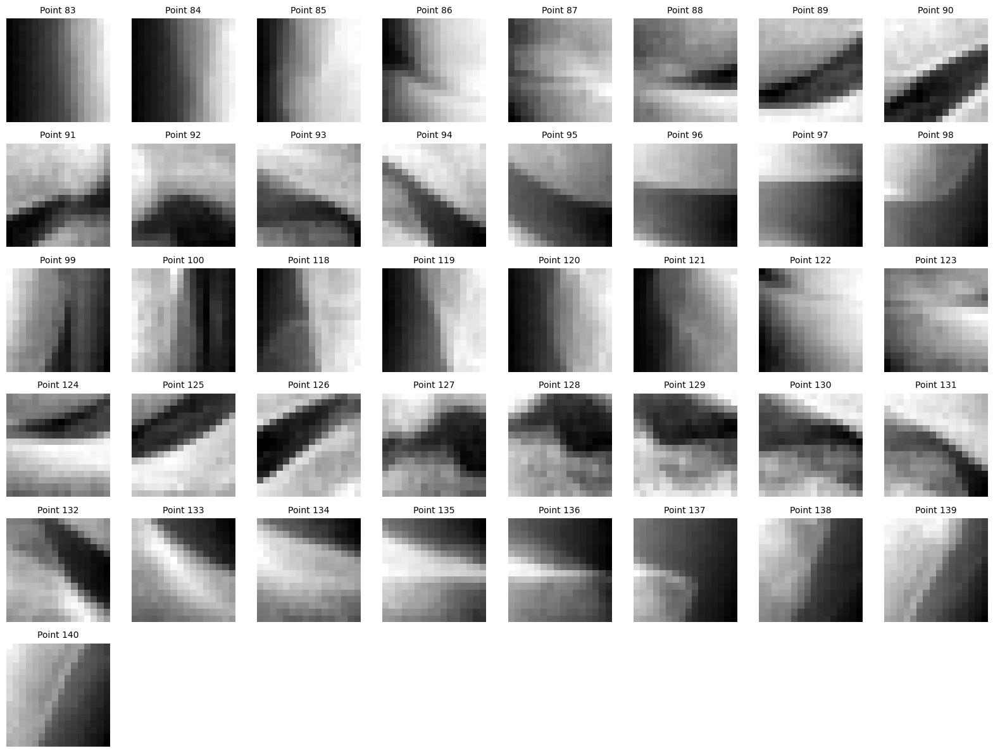

In [14]:
# visualize
import math
import matplotlib.pyplot as plt

# Determine grid size
test_image = test_dataset.__getitem__(81)[0]
n_patches = len(test_image)
n_cols = 8  # You can change this
n_rows = math.ceil(n_patches / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))
range1 = np.arange(9, 27)  # Indices 9 to 26
range2 = np.arange(44, 67) # Indices 44 to 66
PATCH_POINT_INDICES = np.concatenate([range1, range2])
for idx, patch in enumerate(test_image):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    patch = np.transpose(patch, (1, 2, 0))
    ax.imshow(patch, cmap='gray')
    ax.set_title(f"Point {PATCH_POINT_INDICES[idx]+74}", fontsize=10)  # Add title
    ax.axis('off')

    # if PATCH_POINT_INDICES[idx]+74 in [86, 123, 137]:
    #     OUTPUT_DIR = rf"C:\Users\user\Desktop\knee_mil_project\DeepPatch\{folder_name}\seed_{SEED}\demo" # Changed output dir name
    #     if not os.path.exists(OUTPUT_DIR):
    #         os.makedirs(OUTPUT_DIR)
    #         print(f"Created directory: {OUTPUT_DIR}")

    #     save_filename = f"{current_patient_id}_{side}_patch_{PATCH_POINT_INDICES[idx]+74}.png"
    #     save_path = os.path.join(OUTPUT_DIR, save_filename)

    #     try:
    #         fig.savefig(save_path, dpi=150, bbox_inches='tight')
    #         print(f"Figure saved to: {save_path}")
    #     except Exception as e:
    #         print(f"Error saving figure: {e}")

# Hide any unused axes
for idx in range(n_patches, n_rows * n_cols):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()
# with .h5 file, I can work on Google Colab too

# Train/val

In [15]:
from sklearn.metrics import accuracy_score, f1_score, cohen_kappa_score, classification_report
from tqdm import tqdm

DATALOADER_NUM_WORKERS = 0
DATALOADER_PIN_MEMORY = True if DEVICE.type == 'cuda' and DATALOADER_NUM_WORKERS > 0 else False # pin_memory only useful with workers

torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=mil_collate_fn,
    num_workers=DATALOADER_NUM_WORKERS,
    pin_memory=DATALOADER_PIN_MEMORY
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=mil_collate_fn,
    num_workers=DATALOADER_NUM_WORKERS,
    pin_memory=DATALOADER_PIN_MEMORY
)
# test_loader should also be defined here or before the test loop
if 'test_dataset' in globals() and test_dataset is not None: # Check if test_dataset exists
    test_loader = DataLoader(
        test_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        collate_fn=mil_collate_fn,
        num_workers=DATALOADER_NUM_WORKERS,
        pin_memory=DATALOADER_PIN_MEMORY
    )
else:
    test_loader = None
    print("Warning: test_dataset not found, skipping test_loader creation.")


def run_epoch(loader, model, criterion, optimizer, device, is_training, epoch_desc=""):
    """
    Runs a single epoch of training or evaluation.
    """
    if is_training:
        model.train()
    else:
        model.eval()

    total_loss = 0.0
    all_preds = []
    all_labels = []
    num_processed_samples = 0

    progress_bar = tqdm(loader, desc=epoch_desc, leave=False)
    for list_of_patch_bags, labels_batch in progress_bar:
        if list_of_patch_bags is None or not list_of_patch_bags:
            # This might happen if collate_fn decides a batch is entirely invalid
            print(f"Warning: Skipped an entirely invalid batch in {epoch_desc}.")
            continue

        moved_list_of_patch_bags = []
        valid_indices_in_batch = [] # Keep track of which original labels correspond to moved bags

        for i, bag in enumerate(list_of_patch_bags):
            if bag.nelement() > 0:  # Check if bag is not empty
                moved_list_of_patch_bags.append(bag.to(device, non_blocking=DATALOADER_PIN_MEMORY))
                valid_indices_in_batch.append(i)

        if not moved_list_of_patch_bags: # If all bags in this batch were empty after filtering
            # print(f"Warning: All bags in current batch for {epoch_desc} were empty. Skipping.")
            continue

        # Select labels corresponding to the valid bags
        labels_batch = labels_batch[valid_indices_in_batch].to(device, non_blocking=DATALOADER_PIN_MEMORY)

        if is_training:
            optimizer.zero_grad()

        with torch.set_grad_enabled(is_training): # Context manager for gradients
            outputs, _ = model(moved_list_of_patch_bags) # Model takes the list of bags

            # Ensure outputs and labels match in size after potential filtering
            if outputs.shape[0] != labels_batch.shape[0]:
                print(f"Shape mismatch in {epoch_desc}! Outputs: {outputs.shape}, Labels: {labels_batch.shape}. Skipping batch.")
                print(f"  Original num bags in list: {len(list_of_patch_bags)}, Moved: {len(moved_list_of_patch_bags)}")
                continue

            loss = criterion(outputs, labels_batch)

            if is_training:
                loss.backward()
                optimizer.step()

        total_loss += loss.item() * labels_batch.size(0) # loss.item() is avg loss for batch
        num_processed_samples += labels_batch.size(0)

        _, predicted = torch.max(outputs.data, 1)
        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels_batch.cpu().numpy())

        if progress_bar:
            progress_bar.set_postfix(loss=loss.item())

    avg_loss = total_loss / num_processed_samples if num_processed_samples > 0 else 0
    return avg_loss, all_labels, all_preds, num_processed_samples


# --- Training Loop ---
model = CompleteMILModel(
feature_extractor_out_dim=FEATURE_EXTRACTOR_OUT_DIM,
num_classes=NUM_CLASSES,
aggregation_type=AGGREGATION_TYPE
).to(DEVICE)

# # <<<<<<< LOAD PRE-TRAINED WEIGHTS >>>>>>>
# if os.path.exists(PRETRAINED_MODEL_PATH):
#     try:
#         model.load_state_dict(torch.load(PRETRAINED_MODEL_PATH, map_location=DEVICE))
#         print(f"Successfully loaded pre-trained weights from: {PRETRAINED_MODEL_PATH}")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}. Training from scratch.")
# else:
#     print(f"Pre-trained model path not found: {PRETRAINED_MODEL_PATH}. Training from scratch.")


# weighted loss for class imbalance
train_kl_grades = []
with h5py.File(H5_FILE, 'r') as hf:
    for group_name in train_dataset.sample_group_names: # Assuming train_dataset is initialized
        train_kl_grades.append(hf[group_name]['kl_grade'][0])

class_counts = np.bincount(train_kl_grades, minlength=NUM_CLASSES)
# Avoid division by zero if a class is missing in training (should ideally not happen with good splits)
class_weights_raw = 1.0 / (class_counts + 1e-6) # Add epsilon for stability
class_weights_normalized = class_weights_raw / np.sum(class_weights_raw) * NUM_CLASSES # Optional normalization
class_weights_tensor = torch.tensor(class_weights_normalized, dtype=torch.float).to(DEVICE)
print(f"Using class weights: {class_weights_tensor}")
criterion = nn.CrossEntropyLoss(weight=class_weights_tensor)

optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE, weight_decay=wd)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5) # For val_loss

Using class weights: tensor([0.2621, 0.5652, 0.3807, 0.7295, 3.0625], device='cuda:0')


# Test

C:\Users\user\AppData\Local\Temp\ipykernel_31704\2923866702.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(best_model_path_fixed, map_


Loading best model from .\train\model_checkpoints\best_model_val_kappa.pth for testing...



--- Test Results ---
Test Loss: 0.8390
Test Accuracy: 0.6441
Test F1 Score (Weighted): 0.6520
Test weighted Cohen's Kappa: 0.8072

Classification Report:
              precision    recall  f1-score   support

        KL 0       0.76      0.72      0.74       689
        KL 1       0.34      0.44      0.38       319
        KL 2       0.68      0.58      0.63       475
        KL 3       0.79      0.76      0.77       248
        KL 4       0.68      0.88      0.77        59

    accuracy                           0.64      1790
   macro avg       0.65      0.68      0.66      1790
weighted avg       0.67      0.64      0.65      1790



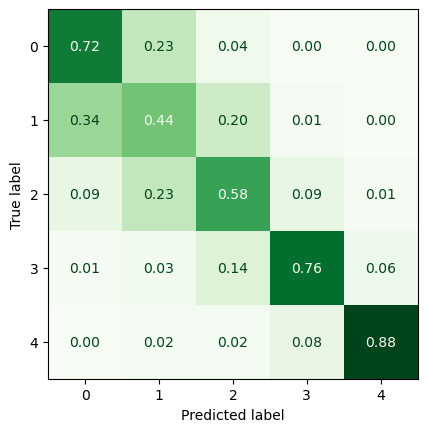

In [9]:
from sklearn.metrics import ConfusionMatrixDisplay
best_model_path_fixed = os.path.join(CHECKPOINT_DIR, "best_model_val_kappa.pth") # Fixed name for best model

# --- Testing Loop (using the best saved model) ---
if os.path.exists(best_model_path_fixed):
    print(f"\nLoading best model from {best_model_path_fixed} for testing...")
    # Ensure model is defined or re-instantiated if not in scope
    if 'model' not in globals() or model is None:
        model = CompleteMILModel(FEATURE_EXTRACTOR_OUT_DIM, NUM_CLASSES, AGGREGATION_TYPE).to(DEVICE)
    model.load_state_dict(torch.load(best_model_path_fixed, map_location=DEVICE))

    if test_loader is not None:
        test_loss, test_labels, test_preds, processed_test_samples = run_epoch(
            test_loader, model, criterion, None, DEVICE, is_training=False,
            epoch_desc="Testing"
        )

        if processed_test_samples > 0:
            test_accuracy = accuracy_score(test_labels, test_preds)
            test_f1 = f1_score(test_labels, test_preds, average='weighted', zero_division=0)
            test_kappa = cohen_kappa_score(test_labels, test_preds, weights="quadratic")

            print("\n--- Test Results ---")
            print(f"Test Loss: {test_loss:.4f}")
            print(f"Test Accuracy: {test_accuracy:.4f}")
            print(f"Test F1 Score (Weighted): {test_f1:.4f}")
            print(f"Test weighted Cohen's Kappa: {test_kappa:.4f}")

            target_names_report = [f"KL {i}" for i in range(NUM_CLASSES)]
            try: # Classification report can fail if only one class is present in predictions/labels
                report = classification_report(test_labels, test_preds, target_names=target_names_report, zero_division=0)
                print("\nClassification Report:")
                print(report)
            except ValueError as e:
                print(f"\nCould not generate classification report: {e}")

            _ = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize="true", cmap=plt.cm.Greens, values_format='.2f', colorbar=False)
            plt.savefig(r".\inference\cm.eps", format='eps', bbox_inches='tight')
            plt.savefig(r".\inference\cm.png", format='png', bbox_inches='tight')

        else:
            print("No samples processed during testing.")
    else:
        print("Test loader not available. Skipping testing.")
else:
    print(f"Best model path not found: {best_model_path_fixed}. Cannot perform testing.")

## Bootstrapping for std

In [11]:
from sklearn.utils import resample

# --- Main Bootstrapping Function ---
def bootstrap_model_performance(
    original_test_pids,
    n_bootstrap_iterations=10,
    base_seed=42
):

    bootstrap_metrics = {
        "accuracies": [],
        "f1_scores": [],
        "kappas": [],
    }
    
    original_n_pids = len(original_test_pids)

    for i in range(n_bootstrap_iterations):
        print(f"--- Bootstrap Iteration {i + 1}/{n_bootstrap_iterations} ---")

        # 1. Resample PIDs with replacement
        # Use a different seed for each resample iteration for variability,
        # but the sequence of seeds is deterministic if base_seed is fixed.
        current_bootstrap_pids = resample(
            original_test_pids,
            replace=True,
            n_samples=original_n_pids, # Sample the same number of PIDs as the original test set
            random_state=base_seed + i
        )

        file_path = rf".\inference\bootstrap\test_pids_bs{i}.txt"

        with open(file_path, 'w') as file:
            for item in current_bootstrap_pids:
                file.write(item + '\n')
        
        if not current_bootstrap_pids:
            print(f"Warning: Bootstrap iteration {i+1} resulted in an empty PID list. Skipping.")
            continue

        # 2. Create Dataset and DataLoader for the current bootstrap sample
        # Assuming KneeMILDataset can handle the list of PIDs directly
        test_dataset_bs = KneeMILDataset(H5_FILE, current_bootstrap_pids, transform=val_test_transform)

        if len(test_dataset_bs) == 0:
            print(f"Warning: Bootstrap iteration {i+1} dataset is empty after filtering PIDs. Skipping.")
            continue

        test_loader_bs = DataLoader(
            test_dataset_bs,
            batch_size=BATCH_SIZE,
            shuffle=False,
            collate_fn=mil_collate_fn,
            num_workers=DATALOADER_NUM_WORKERS,
            pin_memory=DATALOADER_PIN_MEMORY
        )

        # 3. Run inference
        if len(test_loader_bs) == 0:
            print(f"Warning: Bootstrap iteration {i+1} DataLoader is empty. Skipping.")
            continue

        bs_loss, bs_labels, bs_preds, processed_bs_samples = run_epoch(
            test_loader_bs, model, criterion, None, DEVICE, is_training=False,
            epoch_desc=f"Bootstrap Testing {i + 1}"
        )
        # 4. Calculate and store metrics
        if processed_bs_samples > 0 and len(bs_labels) > 0 and len(bs_preds) > 0:
            try:
                accuracy = accuracy_score(bs_labels, bs_preds)
                f1 = f1_score(bs_labels, bs_preds, average='weighted', zero_division=0)
                kappa = cohen_kappa_score(bs_labels, bs_preds, weights="quadratic")

                bootstrap_metrics["accuracies"].append(accuracy)
                bootstrap_metrics["f1_scores"].append(f1)
                bootstrap_metrics["kappas"].append(kappa)

                print(f"Iter {i+1} - Acc: {accuracy:.4f}, F1: {f1:.4f}, Kappa: {kappa:.4f}")

            except ValueError as e:
                print(f"Warning: Could not compute metrics for bootstrap iteration {i+1}: {e}")
                print(f"Labels ({len(bs_labels)}): {np.unique(bs_labels, return_counts=True)}")
                print(f"Preds ({len(bs_preds)}): {np.unique(bs_preds, return_counts=True)}")
        else:
            print(f"Warning: No samples processed or no labels/predictions in bootstrap iteration {i+1}.")

    return bootstrap_metrics



# --- This block demonstrates how to use the bootstrapping function ---
print("\nStarting bootstrapping process...")
bootstrap_results = bootstrap_model_performance(
    original_test_pids=test_pids,
    n_bootstrap_iterations=5, # Start with a smaller number for testing, e.g., 100-200
    base_seed=SEED
)

# --- 3. Analyze and print bootstrap results ---
print("\n--- Bootstrap Performance Statistics ---")
if not bootstrap_results["accuracies"]: # Check if any results were collected
        print("No metrics collected during bootstrapping. Cannot compute statistics.")
else:
    for metric_name, values in bootstrap_results.items():
        if values: # Ensure there are values for this metric
            values_np = np.array(values)
            mean_val = np.mean(values_np)
            std_val = np.std(values_np)

            print(f"\nMetric: {metric_name.capitalize()}")
            print(f"  Number of valid bootstrap estimates: {len(values_np)}")
            print(f"  Mean: {mean_val:.3f}")
            print(f"  Standard Deviation: {std_val:.3f}")
        else:
            print(f"\nMetric: {metric_name.capitalize()} - No values collected.")



Starting bootstrapping process...
--- Bootstrap Iteration 1/5 ---


Iter 1 - Acc: 0.6402, F1: 0.6469, Kappa: 0.8137
--- Bootstrap Iteration 2/5 ---


Iter 2 - Acc: 0.6385, F1: 0.6459, Kappa: 0.8057
--- Bootstrap Iteration 3/5 ---


Iter 3 - Acc: 0.6436, F1: 0.6509, Kappa: 0.8059
--- Bootstrap Iteration 4/5 ---


Iter 4 - Acc: 0.6458, F1: 0.6541, Kappa: 0.7942
--- Bootstrap Iteration 5/5 ---


Iter 5 - Acc: 0.6358, F1: 0.6456, Kappa: 0.8072

--- Bootstrap Performance Statistics ---

Metric: Accuracies
  Number of valid bootstrap estimates: 5
  Mean: 0.641
  Standard Deviation: 0.004

Metric: F1_scores
  Number of valid bootstrap estimates: 5
  Mean: 0.649
  Standard Deviation: 0.003

Metric: Kappas
  Number of valid bootstrap estimates: 5
  Mean: 0.805
  Standard Deviation: 0.006


# Patch GradCAM

Set customized heatmap

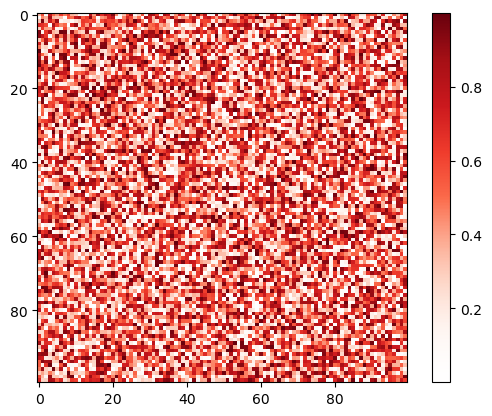

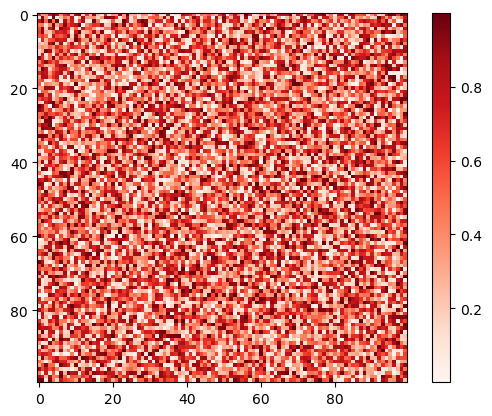

In [16]:
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, LayerCAM

# 1. grab the regular “Reds” array (256×4 RGBA)
ncolors = 256
base = plt.get_cmap('Reds')(np.arange(ncolors))

# 2. set alpha from 0 (white) → 1 (red)
idx = np.arange(ncolors)
v = idx / (ncolors - 1)
alpha = np.where(v >= 0.5, 1.0, 2 * v)
base[:, -1] = alpha

# 3. create a new colormap
reds_alpha = LinearSegmentedColormap.from_list('Reds_alpha', base)

# 4. use it on some data
fig, ax = plt.subplots()
h = ax.imshow(np.random.rand(100,100), cmap=reds_alpha)
plt.colorbar(h, ax=ax)
plt.show()


f,ax = plt.subplots()
h = ax.imshow(np.random.rand(100,100),cmap='Reds')
plt.colorbar(mappable=h)

In [17]:
def get_values_by_id(txt_file, search_id, column_name):
    """
    Retrieve two values for SIDE=1 (right) and SIDE=2 (left) where READPRJ=15 for a given ID.
    If READPRJ=15 is not found, fallback to READPRJ=37 or READPRJ=42.

    Parameters:
    - txt_file: numpy array containing the text data.
    - search_id: str, the ID to search for (first column).
    - column_name: str, the name of the column to retrieve value from.

    Returns:
    - Tuple (value_for_SIDE_1, value_for_SIDE_2) or -1 if not found.
    """
    # Extract header row (first row)
    headers = txt_file[0]

    # Find column indices
    # Convert headers to uppercase for case-insensitive checking
    headers_upper = [header.upper() for header in headers] # some headers are in lowercases
    if column_name not in headers_upper:
        print(f"Column '{column_name}' not found!")
        return None, None


    col_index = np.where(np.char.upper(headers) == column_name)[0][0]  # Target column
    side_index = np.where(headers == "SIDE")[0][0]  # 'SIDE' column index
    readprj_index = np.where(np.char.upper(headers) == "READPRJ")[0][0]  # 'READPRJ' column index; some will be in lowercase

    # Try priority READPRJ values in order: 15 → 37 → 42
    readprj_priority = ["15", "37", "42"]
    
    value_1, value_2 = None, None  # Variables to store values

    for readprj in readprj_priority:
        for row in txt_file[1:]:  # Skip header row
            if row[0] == search_id and row[readprj_index] == readprj:  # Match ID and READPRJ
                if row[side_index] == "1":
                    value_1 = row[col_index]
                elif row[side_index] == "2":
                    value_2 = row[col_index]
        
        # If both SIDE=1 and SIDE=2 are found, stop searching
        if value_1 is not None and value_2 is not None:
            if readprj != "15":
                print(f"Using READPRJ={readprj} for ID {search_id} because READPRJ=15 is missing.")
            break
    
    # Handle empty strings and convert to int safely
    def safe_int(value):
        return int(value) if value and value.strip() != '' else None

    value_1 = safe_int(value_1)
    value_2 = safe_int(value_2)

    # If any value is still missing, print a warning
    if value_1 is None:
        print(f"Data missing for ID {search_id}: SIDE=1 not found in READPRJ=15, 37, or 42!")
        value_1 = -999
    if value_2 is None:
        print(f"Data missing for ID {search_id}: SIDE=2 not found in READPRJ=15, 37, or 42!")
        value_2 = -999

    return value_1, value_2

In [18]:
target_id = "9932578"
target_side = "R"
index = np.where(np.array(test_pids)==target_id + "_" + target_side)[0].item()

TXT_FILE_PATH = r"kxr_sq_bu00.txt" # Path to the master TXT file

txt_file = np.loadtxt(TXT_FILE_PATH, dtype=str, delimiter="|", ndmin=2)
side_num = 0 if test_pids[index][8] == "R" else 1
print(f"KL{get_values_by_id(txt_file, target_id, 'V00XRKL')[side_num]}")
print(f"OSFM={get_values_by_id(txt_file, target_id, 'V00XROSFM')[side_num]}")
print(f"OSTM={get_values_by_id(txt_file, target_id, 'V00XROSTM')[side_num]}")
print(f"OSFL={get_values_by_id(txt_file, target_id, 'V00XROSFL')[side_num]}")
print(f"OSTL={get_values_by_id(txt_file, target_id, 'V00XROSTL')[side_num]}")
print(f"JSM={get_values_by_id(txt_file, target_id, 'V00XRJSM')[side_num]}")
print(f"JSL={get_values_by_id(txt_file, target_id, 'V00XRJSL')[side_num]}")


KL4
OSFM=3
OSTM=0
OSFL=1
OSTL=2
JSM=0
JSL=3


In [19]:
target_layer = [model.patch_feature_extractor.conv_block3[0]]
print(target_layer)

# index

patches_test, label = test_dataset.__getitem__(index)
patch_bag_tensor = torch.stack(patches_test).to(DEVICE)  # shape: [41, 1, 16, 16]
print(test_pids[index], label)

model.eval()
logits, att_scores = model([patch_bag_tensor])       # 前向
# 選你要觀察的 target class（這裡用最高分的那一類）
target_class = logits.argmax(dim=1).item()
score = logits[0, target_class]               # 該類別的得分
# print(logits, score)
print(np.round(F.softmax(logits, dim=1).cpu().detach().numpy()[0], 2))
print(target_class)
model.zero_grad()
score.backward(retain_graph=True)             # 反向

def normalize_attention_scores(scores):
    min_s = np.min(scores)
    max_s = np.max(scores)
    if max_s == min_s: # Avoid division by zero
        return np.zeros_like(scores) if min_s == 0 else np.ones_like(scores) * 0.5
    return (scores - min_s) / (max_s - min_s)
att_scores_cpu = att_scores.detach().squeeze().cpu().numpy()
att_scores_norm = normalize_attention_scores(att_scores_cpu)

[Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))]
9932578_R tensor(4)
[0.2  0.18 0.2  0.22 0.2 ]
3


In [20]:
cam = GradCAM(
    model=model.patch_feature_extractor,     
    target_layers=target_layer,
    )
campp = GradCAMPlusPlus(
    model=model.patch_feature_extractor,     
    target_layers=target_layer,
    )
scam = ScoreCAM(
    model=model.patch_feature_extractor,     
    target_layers=target_layer,
    )
acam = AblationCAM(
    model=model.patch_feature_extractor,    
    target_layers=target_layer,
    )
lcam = LayerCAM(
    model=model.patch_feature_extractor,     
    target_layers=target_layer,
    )

In [21]:
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

# batch_size = 41
batch_size = patch_bag_tensor.shape[0]
# 1) 準備 targets list，同一個 target_class 重複 batch_size 次
targets = [ ClassifierOutputTarget(target_class) ] * batch_size

# 2) 一次跑 CAM，回傳 shape = (batch_size, H, W)
grayscale_cams = cam(
    input_tensor=patch_bag_tensor,   # shape [41,1,16,16]
    targets=targets
)
grayscale_camspp = campp(
    input_tensor=patch_bag_tensor,   # shape [41,1,16,16]
    targets=targets
)
grayscale_scam = scam(
    input_tensor=patch_bag_tensor,   # shape [41,1,16,16]
    targets=targets
)
grayscale_acam = acam(
    input_tensor=patch_bag_tensor,   # shape [41,1,16,16]
    targets=targets
)
grayscale_lcam = lcam(
    input_tensor=patch_bag_tensor,   # shape [41,1,16,16]
    targets=targets
)
print(grayscale_cams.shape)

100%|██████████| 4/4 [00:00<00:00, 143.89it/s]

(41, 16, 16)


## Visual comparison

Displaying grid for: GradCAM


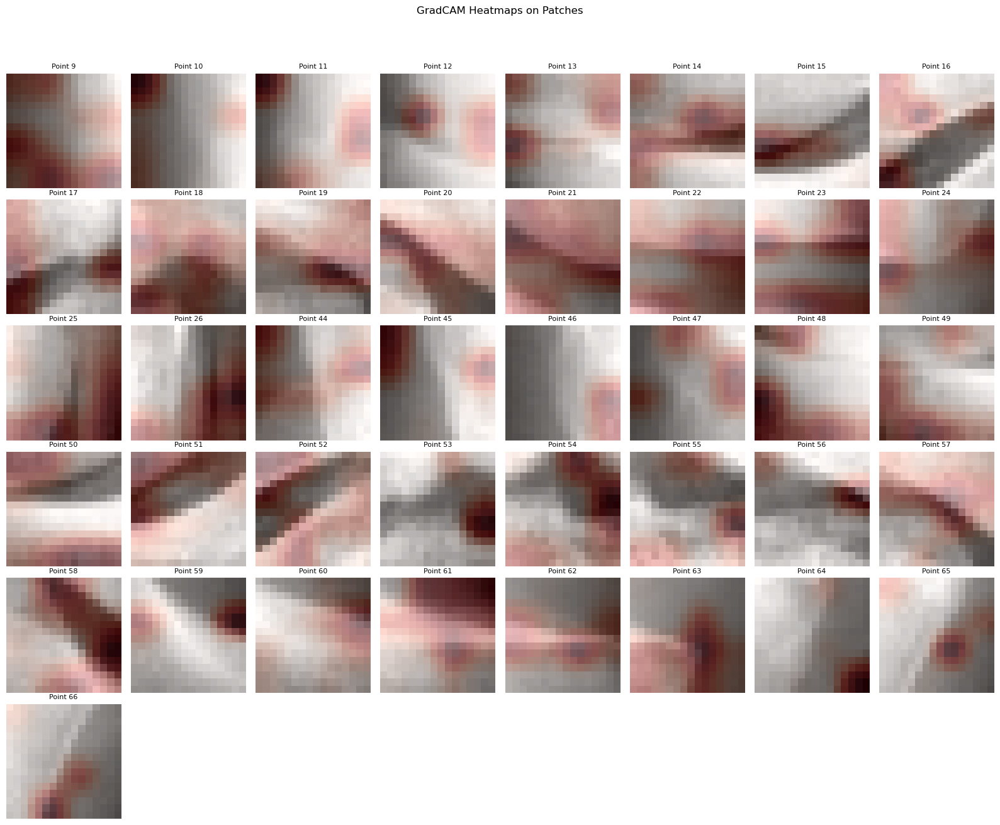

Displaying grid for: GradCAM++


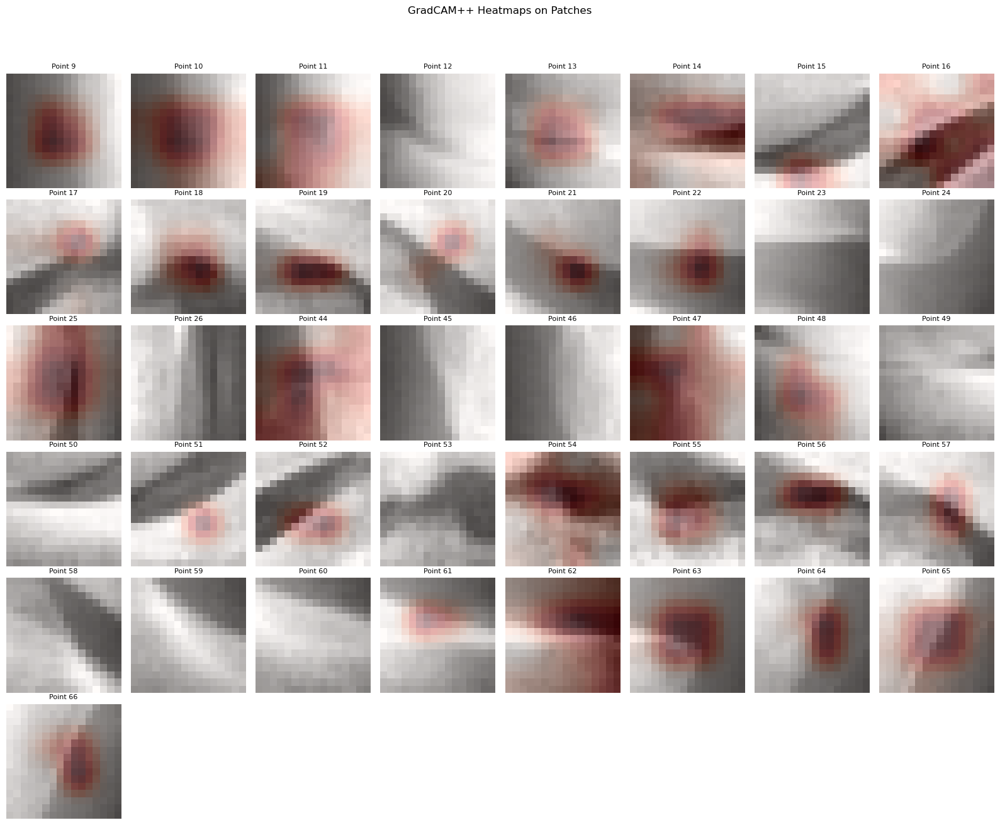

Displaying grid for: ScoreCAM


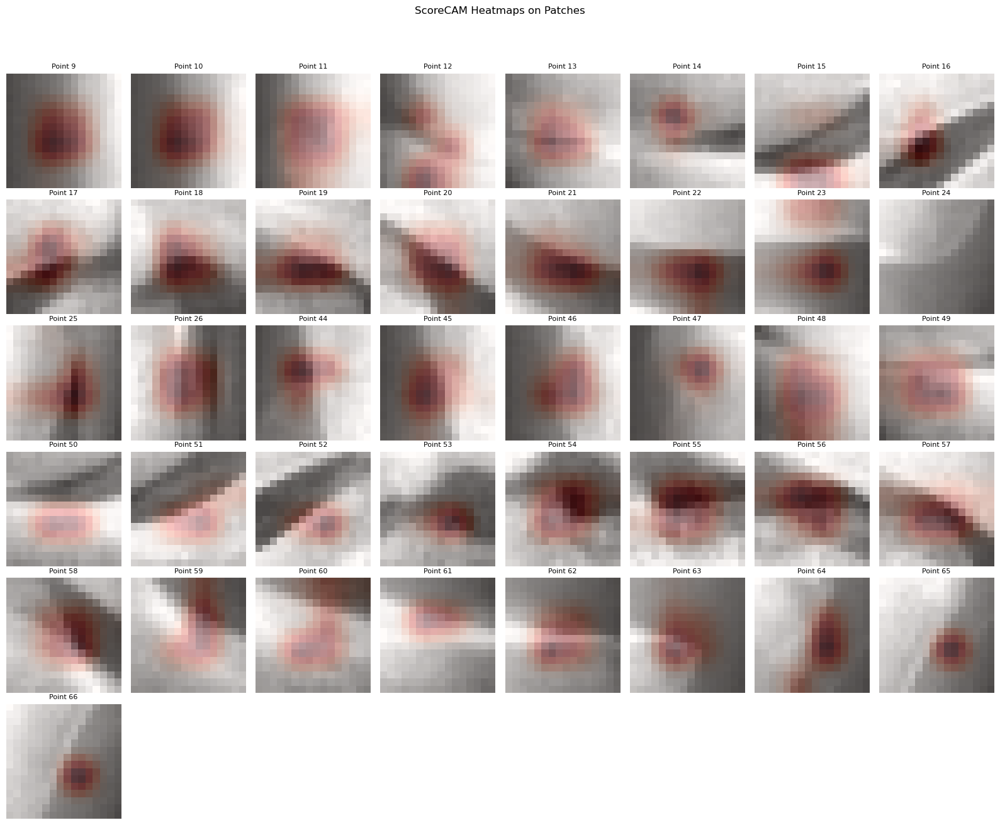

Displaying grid for: AblationCAM


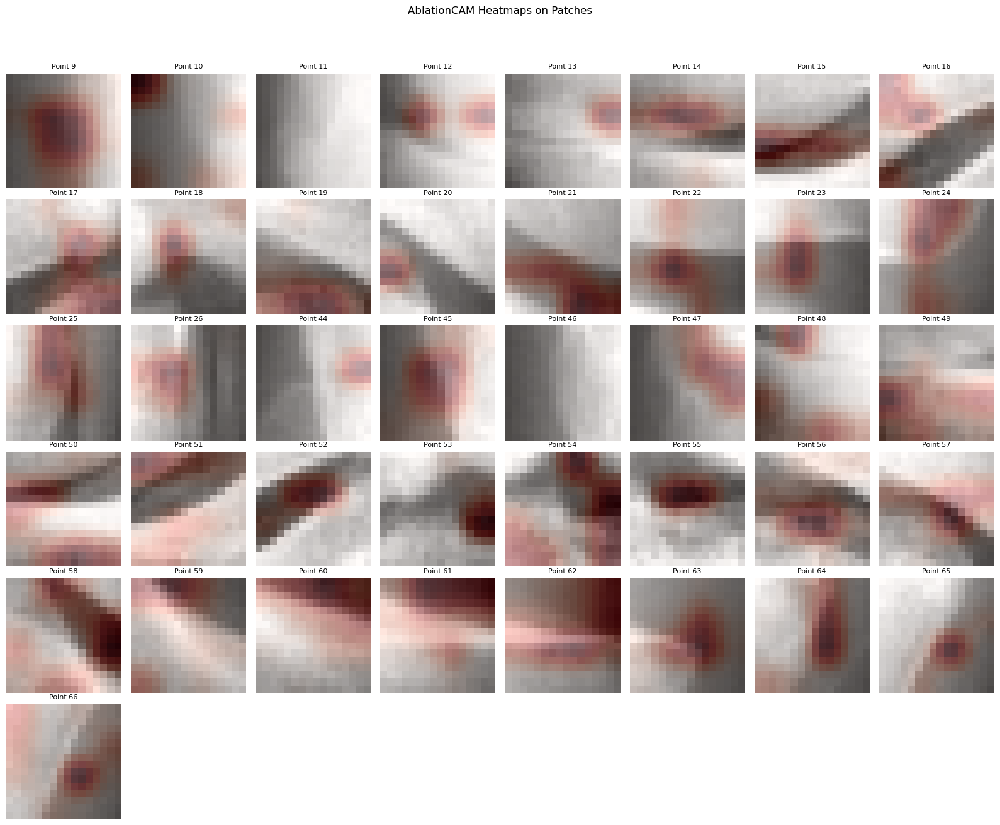

Displaying grid for: LayerCAM


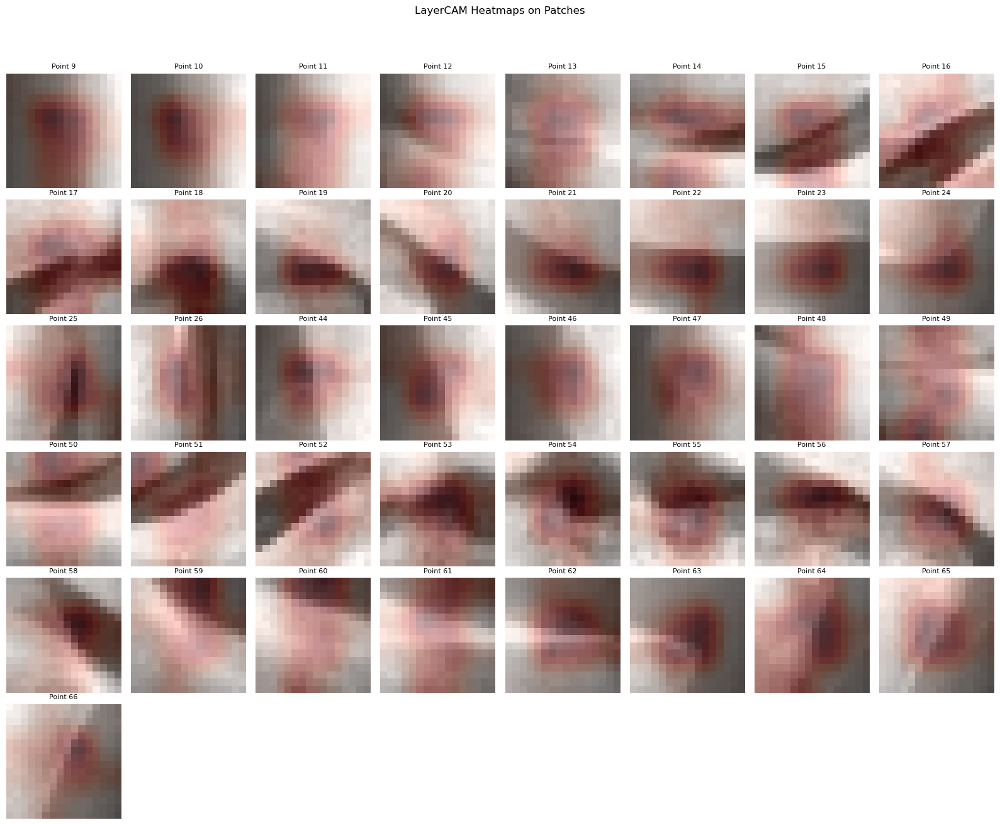

Displaying grid for: ensemble


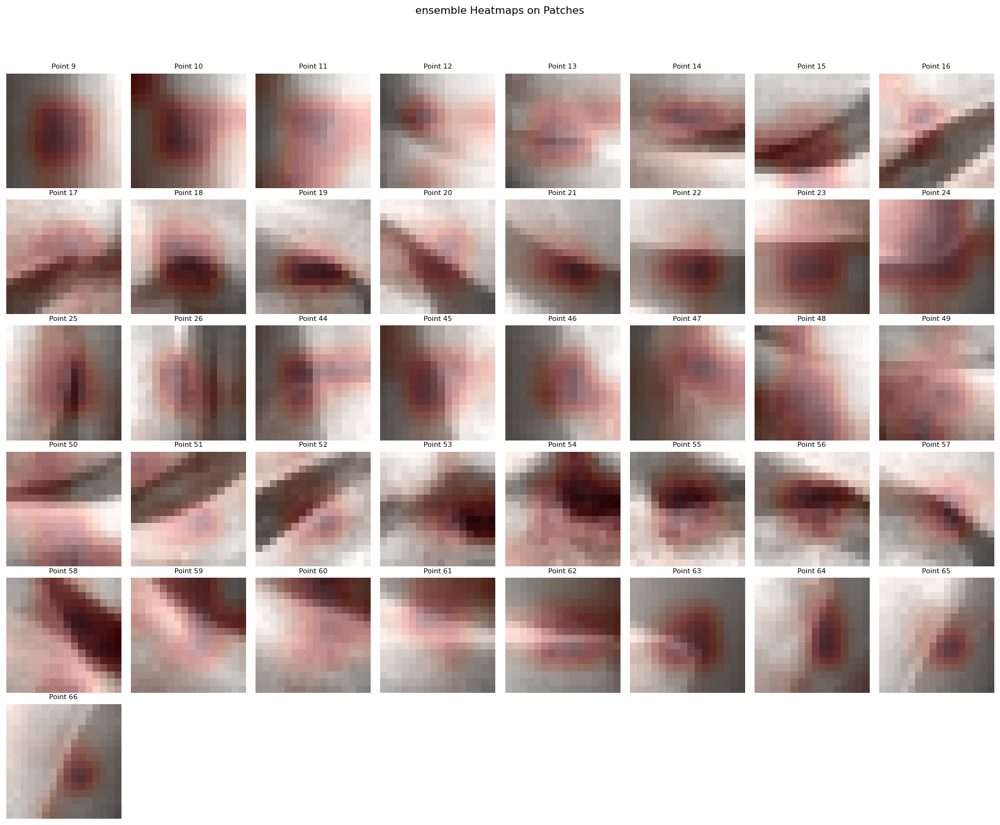

In [19]:
cmap = plt.get_cmap('Reds')

# --- Constants and Configuration ---
DEFAULT_N_COLS_GRID = 8
DEFAULT_PATCH_CMAP = 'gray'
DEFAULT_HEATMAP_CMAP = cmap
DEFAULT_HEATMAP_ALPHA = 0.3
DEFAULT_TITLE_FONTSIZE = 8
DEFAULT_INTERPOLATION = 'nearest'

# --- Helper Function for Plotting Grid ---

def plot_patches_grid_with_heatmaps(
    patches_list,
    heatmaps_list,
    patch_indices_map,
    num_cols=DEFAULT_N_COLS_GRID,
    figure_title="",
    patch_cmap=DEFAULT_PATCH_CMAP,
    heatmap_cmap=DEFAULT_HEATMAP_CMAP,
    base_heatmap_alpha=DEFAULT_HEATMAP_ALPHA,
    attention_scores_norm=None, # Optional: for alpha modulation
    title_fontsize=DEFAULT_TITLE_FONTSIZE,
    interpolation_method=DEFAULT_INTERPOLATION
):
    """
    Displays a grid of image patches with overlaid heatmaps.

    Args:
        patches_list (list/np.array): List of image patches (each a NumPy array).
        heatmaps_list (list/np.array): List of heatmaps corresponding to patches.
        patch_indices_map (list/np.array): List of original indices/labels for titles.
        num_cols (int): Number of columns in the grid.
        figure_title (str): Overall title for the figure.
        patch_cmap (str): Colormap for the base patches.
        heatmap_cmap (str): Colormap for the heatmaps.
        base_heatmap_alpha (float): Base alpha transparency for heatmaps.
        attention_scores_norm (list/np.array, optional): Normalized attention scores.
                                                        If provided, heatmap_alpha = base_heatmap_alpha * score.
        title_fontsize (int): Font size for individual patch titles.
        interpolation_method (str): Interpolation method for imshow.
    """
    if not patches_list:
        print("No patches to display.")
        return

    n_patches = len(patches_list)
    if n_patches != len(heatmaps_list) or n_patches != len(patch_indices_map):
        print("Error: Mismatch in lengths of patches, heatmaps, or patch_indices_map.")
        return

    n_rows = math.ceil(n_patches / num_cols)

    fig, axes = plt.subplots(n_rows, num_cols, figsize=(num_cols * 2, n_rows * 2.2)) # Slightly taller for titles
    
    # Flatten axes array for easier indexing, handling single row/col cases
    if n_rows * num_cols > 1:
        axes = axes.flatten()
    elif n_rows * num_cols == 1: # Single subplot
        axes = [axes] 
    else: # No subplots if n_patches is 0 (already handled)
        return

    for idx in range(n_patches):
        ax = axes[idx]
        patch = patches_list[idx]
        heatmap = heatmaps_list[idx]

        # Prepare patch (squeeze to 2D if needed)
        patch_np = patch.squeeze()

        # Plot base patch
        ax.imshow(patch_np, cmap=patch_cmap, interpolation=interpolation_method)

        # Determine heatmap alpha
        current_alpha = base_heatmap_alpha
        if attention_scores_norm is not None and idx < len(attention_scores_norm):
            current_alpha *= attention_scores_norm[idx]
            current_alpha = np.clip(current_alpha, 0.0, 1.0) # Ensure alpha is valid

        # Overlay heatmap
        ax.imshow(heatmap, cmap=heatmap_cmap, alpha=current_alpha, interpolation=interpolation_method)

        # Set title and turn off axis
        ax.set_title(f"Point {patch_indices_map[idx]}", fontsize=title_fontsize)
        ax.axis('off')

    # Hide any unused subplots
    for idx in range(n_patches, n_rows * num_cols):
        axes[idx].axis('off')

    if figure_title:
        fig.suptitle(figure_title, fontsize=title_fontsize + 4, y=0.99) # Adjust y to prevent overlap

    plt.tight_layout(rect=[0, 0, 1, 0.95 if figure_title else 0.98]) # Adjust rect for suptitle
    plt.show()


# --- Main Execution Logic ---

# Calculate PATCH_POINT_INDICES (do this once)
range1 = np.arange(9, 27)  # Indices 9 to 26
range2 = np.arange(44, 67) # Indices 44 to 66
PATCH_POINT_INDICES = np.concatenate([range1, range2])

# --- Call the plotting function for each CAM method ---

# For more concise looping if parameters are mostly the same:
cam_data_sources = {
    "GradCAM": grayscale_cams,
    "GradCAM++": grayscale_camspp,
    "ScoreCAM": grayscale_scam,
    "AblationCAM": grayscale_acam,
    "LayerCAM": grayscale_lcam
}
grayscale_ensemble = None
for item in cam_data_sources:
    if grayscale_ensemble is None:
        grayscale_ensemble = 1 / len(cam_data_sources) * cam_data_sources[item]
    else:
        grayscale_ensemble = grayscale_ensemble + 1 / len(cam_data_sources) * cam_data_sources[item]

cam_data_sources["ensemble"] = grayscale_ensemble

for method_name, heatmaps in cam_data_sources.items():
    print(f"Displaying grid for: {method_name}")
    # Make sure 'patches_test' and 'PATCH_POINT_INDICES' are defined and have the correct data
    # Also, ensure 'heatmaps' (i.e., grayscale_cams, etc.) are defined.
    # If 'att_scores_norm' is used, ensure it's defined too.
    
    # Example:
    # if 'patches_test' not in globals() or 'PATCH_POINT_INDICES' not in globals() or method_name not in globals():
    #    print(f"Skipping {method_name} due to missing data. Please define patches_test, PATCH_POINT_INDICES, and heatmaps.")
    #    continue

    plot_patches_grid_with_heatmaps(
        patches_list=patches_test,             # Replace with your actual patches data
        heatmaps_list=heatmaps,                # This will be grayscale_cams, grayscale_camsp, etc.
        patch_indices_map=PATCH_POINT_INDICES, # Replace with your actual indices
        figure_title=f"{method_name} Heatmaps on Patches",
        # attention_scores_norm=att_scores_norm, # Uncomment if using this
        base_heatmap_alpha=0.3 # Explicitly setting the alpha from your original code
    )

# Attention-weighted saliency maps

In [22]:
import numpy as np
SEED=42
id_shapeLR_kl_V00 = np.load(r".\inference\id_shapeLR_V00.npz")
test_id_pred_V00 = np.load(r".\inference\test_pred.npz")
test_id_att_V00 = np.load(r".\inference\test_att_scores.npz")

In [23]:
patient_ids = id_shapeLR_kl_V00["id"]
kl_grades_L_np = id_shapeLR_kl_V00["KL_L"]
kl_grades_R_np = id_shapeLR_kl_V00["KL_R"]
shapes_L_2d = id_shapeLR_kl_V00["shapes_L"]
shapes_R_2d = id_shapeLR_kl_V00["shapes_R"]

test_ids = test_id_pred_V00["id"] # involve sides
test_preds = test_id_pred_V00["prob"]
test_att_scores = test_id_att_V00["att_scores"]
test_kls = test_id_pred_V00["true_kl"]

In [24]:
def normalize_attention_scores(scores):
    min_s = np.min(scores)
    max_s = np.max(scores)
    if max_s == min_s: # Avoid division by zero
        return np.zeros_like(scores) if min_s == 0 else np.ones_like(scores) * 0.5
    return (scores - min_s) / (max_s - min_s)

# Adapt from Tiulpin et al. (2018)
def process_xray(img, cut_min=5, cut_max=99, multiplier=255):
    """
    This function changes the histogram of the image by doing global contrast normalization
    
    Parameters
    ----------
    img : array_like
        Image
    cut_min : int
         Low percentile to trim
    cut_max : int
        Highest percentile trim
    multiplier : int
        Multiplier to apply after global contrast normalization
        
    Returns
    -------
    array_like
        Returns a processed image
    
    """

    img = img.copy()
    lim1, lim2 = np.percentile(img, [cut_min, cut_max])
    img[img < lim1] = lim1
    img[img > lim2] = lim2

    img -= lim1
    img /= img.max()
    img *= multiplier
    return img

def patchFromPoint(point, size):
    '''
    point : the landmark
    size  : half of the length of the box (square)
    '''
    topLeft = (int(point[0] - size), int(point[1] - size))
    botRight = (int(point[0] + size), int(point[1] + size))
    return topLeft, botRight

In [25]:
index_test = index
pid_side = test_pids[index_test]
pid, side = str.split(pid_side, "_")
index_all = np.where(np.array(patient_ids) == pid)[0].item()
print(f"{test_ids[index_test]}, {patient_ids[index_all]}, L: {kl_grades_L_np[index_all]}, R: {kl_grades_R_np[index_all]}")
print("Prediction:")
print(" ".join(f"{x:.5f}" for x in test_preds[index_test]))
print(index_test)
if np.argmax(test_preds[index_test]) == test_kls[index_test]:
    print("Correct!")
else:
    print("Wrong!")



att_scores = test_att_scores[index_test]
att_scores = normalize_attention_scores(att_scores)

9932578_R, 9932578, L: 0, R: 4
Prediction:
0.00000 0.00003 0.00271 0.23289 0.76438
81
Correct!


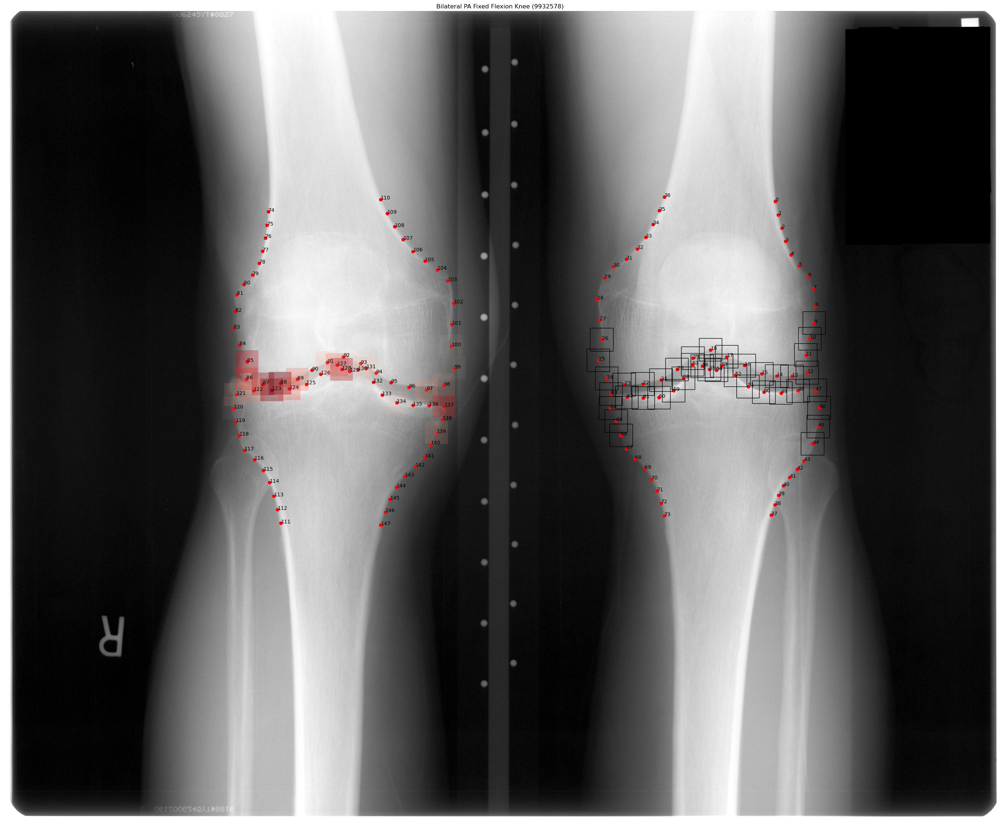

In [26]:
import pydicom
import matplotlib.patches as patches

# 建立 colormap 與正規化函式
cmap = plt.get_cmap('Reds')

file_path = rf".\inference\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index_all]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
# 開圖
fig, ax = plt.subplots(figsize=(35, 43))
ax.imshow(image, cmap='gray')
ax.axis('off')
ax.set_title(f"{dicom_data.SeriesDescription} ({patient_ids[index_all]})")

# （如果你還要畫紅點和編號，就保留你原本的 scatter+annotate 這段）
ax.scatter(shapes_L_2d[index_all][:,0], shapes_L_2d[index_all][:,1], c='red')
ax.scatter(shapes_R_2d[index_all][:,0], shapes_R_2d[index_all][:,1], c='red')
for i_pt in range(len(shapes_L_2d[index_all])):
    ax.annotate(str(i_pt), shapes_L_2d[index_all][i_pt], color='black')
    ax.annotate(str(i_pt+len(shapes_L_2d[index_all])),
                shapes_R_2d[index_all][i_pt], color='black')

# 用你原本的 PATCH_POINT_INDICES 和 patchFromPoint
range1 = np.arange(9, 27)
range2 = np.arange(44, 67)
PATCH_POINT_INDICES = np.concatenate([range1, range2])
for id, i in enumerate(PATCH_POINT_INDICES):
    # 左膝
    w = att_scores[id]
    rgba = cmap(w)
    topLeft, botRight = patchFromPoint(shapes_L_2d[index_all][i], size=size)
    if side == "L":
        rectL = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=1,
            edgecolor='none',
            facecolor=rgba,
            alpha=0.4*w
        )
    else:
        rectL = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=1,
            edgecolor='black',
            facecolor='none',
            alpha=1
        )
    ax.add_patch(rectL)

    # 右膝
    topLeft, botRight = patchFromPoint(shapes_R_2d[index_all][i], size=size)
    if side == "R":
        rectR = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=1,
            edgecolor='none',
            facecolor=rgba,
            alpha=0.4*w
        )
    else:
        rectR = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=1,
            edgecolor='black',
            facecolor='none',
            alpha=1
        )
    ax.add_patch(rectR)

plt.show()

## Comparison

Plotting: GradCAM on subplot 1
Plotting: GradCAM++ on subplot 2
Plotting: ScoreCAM on subplot 3
Plotting: AblationCAM on subplot 4
Plotting: LayerCAM on subplot 5
Plotting: Ensemble on subplot 6
Figure saved to: .\ecam\9932578_R.png


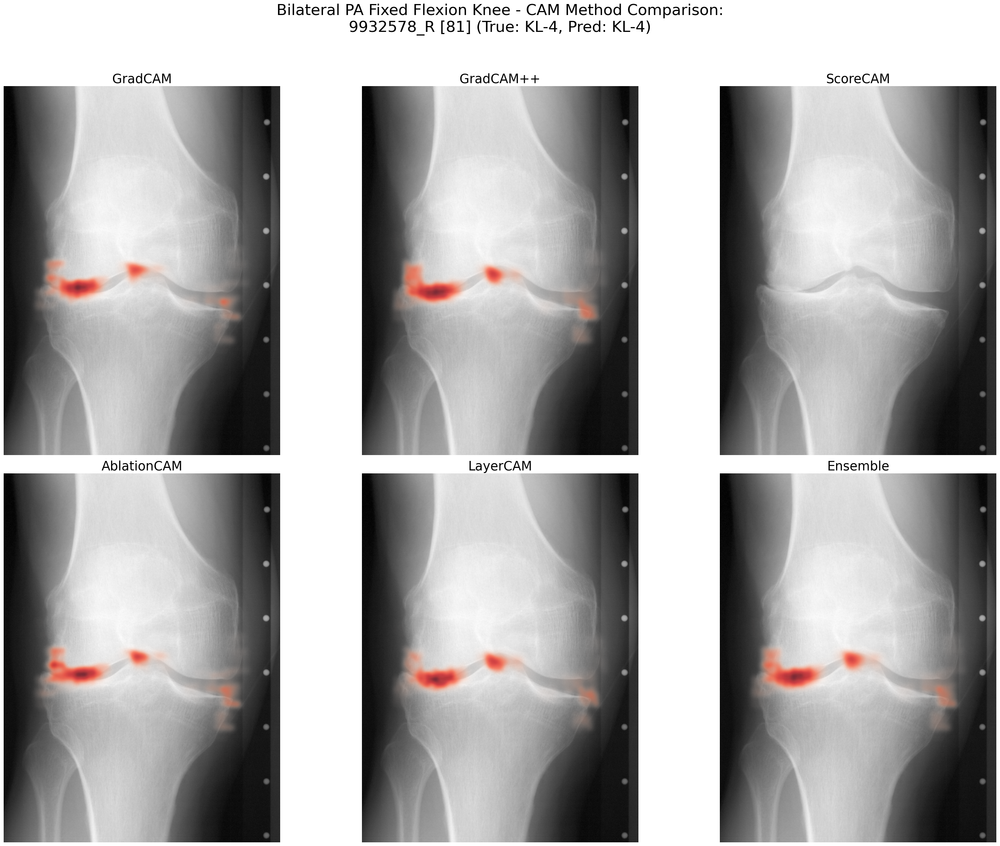

In [28]:
import cv2 # Make sure cv2 is imported
from scipy.ndimage import gaussian_filter

# --- Constants and Configuration ---
ALPHA = 0.8 # Base alpha for heatmaps
# CMAP will be defined using reds_alpha in the main execution section

SUBPLOT_FIG_WIDTH = 10
SUBPLOT_FIG_HEIGHT = 12

# --- Helper Functions ---
def load_and_preprocess_dicom(file_path_template, patient_id, process_xray_func, low_perc=5, high_perc=99, max_val=65535):
    """Loads DICOM, extracts pixel array, and preprocesses it."""
    file_path = file_path_template.format(patient_id=patient_id)
    dicom_data = pydicom.dcmread(file_path)
    image = dicom_data.pixel_array.copy().astype(np.float64)
    image = process_xray_func(image, low_perc, high_perc, max_val)
    image = image.reshape((dicom_data.Rows, dicom_data.Columns))
    return dicom_data, image

def calculate_patch_sizes(image_shape, ref_patch_dim=100, ref_img_area=(3560 * 4320)):
    """
    Calculates dynamic patch size based on image dimensions.
    Returns:
        size_factor (float): Half the dimension of the patch (e.g., radius for a square patch).
        new_size_tuple (tuple): (width, height) for the patch, used for resizing heatmaps.
    """
    img_area = image_shape[0] * image_shape[1]
    # Calculate a factor representing "half patch dimension" relative to reference
    size_factor = (ref_patch_dim / np.sqrt(ref_img_area)) * np.sqrt(img_area) / 2.0
    patch_dim = round(size_factor * 2) # Full patch dimension
    new_size_tuple = (patch_dim, patch_dim) # Assuming square patches (width, height)
    return size_factor, new_size_tuple

# --- Modified Visualization Function ---
def plot_heatmaps_on_ax(
    ax,
    dicom_data, base_image, # base_image is already preprocessed
    shapes_L_current, shapes_R_current,
    patch_point_indices,
    current_grayscale_cams, current_att_scores,
    patch_half_size_val, patch_dims_tuple_val, # patch_dims_tuple_val is (width, height)
    cmap_obj, base_alpha_val, target_side_focus,
    patch_from_point_func,
    method_name=""
):
    """
    Plots base image and a single summed heatmap (from all patches) for a specific CAM method.
    """
    hh_img, ww_img = base_image.shape # Full image dimensions

    # Determine zoom boundaries based on active landmarks for the current side
    active_side_shapes = shapes_L_current if target_side_focus == "L" else shapes_R_current

    if active_side_shapes.size > 0:
        min_coords = np.min(active_side_shapes, axis=0) # [x_min, y_min]
        max_coords = np.max(active_side_shapes, axis=0) # [x_max, y_max]
        
        # Padding: Use 2 * patch_width for padding around landmark bounding box
        padding_amount = 2 * patch_dims_tuple_val[0] 

        w_min_zoomed = min_coords[0] - padding_amount
        h_min_zoomed = min_coords[1] - padding_amount # y-coords in image space (origin top-left)
        w_max_zoomed = max_coords[0] + padding_amount
        h_max_zoomed = max_coords[1] + padding_amount
    else: # Default to full image if no relevant landmarks
        w_min_zoomed, h_min_zoomed = 0, 0
        w_max_zoomed, h_max_zoomed = ww_img, hh_img

    # Plot base image
    ax.imshow(base_image, cmap='gray', origin='upper', extent=(0, ww_img, hh_img, 0), zorder=0)
    ax.set_xlim(max(0, w_min_zoomed), min(ww_img, w_max_zoomed))
    # For set_ylim with inverted y-axis: ylim(y_bottom, y_top) where y_bottom > y_top
    ax.set_ylim(min(hh_img, h_max_zoomed), max(0, h_min_zoomed))
    ax.axis('off')

    title_str = f"{method_name}" if method_name else ""
    ax.set_title(title_str, fontsize=25)

    # Error checking for list lengths
    num_expected_patches = len(patch_point_indices)
    if len(current_grayscale_cams) != num_expected_patches:
        print(f"Warning for {method_name} ({target_side_focus}): Mismatch in heatmap count. Expected {num_expected_patches}, got {len(current_grayscale_cams)}.")
        ax.text(0.5, 0.5, "Heatmap data error", ha="center", va="center", transform=ax.transAxes, color="red", fontsize=12)
        return
    if len(current_att_scores) != num_expected_patches:
        print(f"Warning for {method_name} ({target_side_focus}): Mismatch in attention score count. Expected {num_expected_patches}, got {len(current_att_scores)}.")
        ax.text(0.5, 0.5, "Attention score data error", ha="center", va="center", transform=ax.transAxes, color="red", fontsize=12)
        return

    # 1. Initialize an empty heatmap canvas (float for accumulation)
    summed_heatmap_canvas = np.zeros_like(base_image, dtype=np.float64)
    H_canvas, W_canvas = summed_heatmap_canvas.shape

    for id_patch, point_idx in enumerate(patch_point_indices):
        current_side_shapes_for_idx_check = shapes_L_current if target_side_focus == "L" else shapes_R_current
        if point_idx >= current_side_shapes_for_idx_check.shape[0]:
            print(f"Warning for {method_name} ({target_side_focus}): point_idx {point_idx} is out of bounds for current side landmarks. Skipping patch {id_patch}.")
            continue

        heatmap_original_patch = current_grayscale_cams[id_patch]
        attention_w = current_att_scores[id_patch]

        center_point = None
        flip_heatmap_flag = False
        
        # Determine center point and flip flag based on target_side_focus
        if target_side_focus == "L":
            center_point = shapes_L_current[point_idx]
            flip_heatmap_flag = True 
        elif target_side_focus == "R":
            center_point = shapes_R_current[point_idx]
            flip_heatmap_flag = False
        
        # Resize raw patch heatmap. patch_dims_tuple_val is (width, height).
        resized_patch_heatmap = cv2.resize(heatmap_original_patch, patch_dims_tuple_val, interpolation=cv2.INTER_LINEAR)
        if flip_heatmap_flag:
            resized_patch_heatmap = np.fliplr(resized_patch_heatmap)
        
        # Get patch coordinates on the full image. `patch_half_size_val` is used by patch_from_point_func.
        topLeft_float, botRight_float = patch_from_point_func(center_point, size=patch_half_size_val)
        
        # Absolute coordinates on the canvas (integer, for slicing)
        x0_abs_canvas = int(round(topLeft_float[0]))
        y0_abs_canvas = int(round(topLeft_float[1]))
        x1_abs_canvas = int(round(botRight_float[0]))
        y1_abs_canvas = int(round(botRight_float[1]))

        # Dimensions of the target box on the canvas for this patch
        target_box_width = x1_abs_canvas - x0_abs_canvas
        target_box_height = y1_abs_canvas - y0_abs_canvas

        if target_box_width <= 0 or target_box_height <= 0:
            # print(f"Debug: Patch {id_patch} for {method_name} has non-positive dimensions after rounding. Skipping.")
            continue

        # Ensure the heatmap to be placed matches the integer dimensions of the target box.
        # This handles discrepancies from float rounding of topLeft/botRight vs. patch_dims_tuple_val.
        if resized_patch_heatmap.shape[0] != target_box_height or \
           resized_patch_heatmap.shape[1] != target_box_width:
            heatmap_to_place_on_canvas = cv2.resize(resized_patch_heatmap, (target_box_width, target_box_height), interpolation=cv2.INTER_LINEAR)
        else:
            heatmap_to_place_on_canvas = resized_patch_heatmap
        
        # Determine the valid intersection of this patch with the canvas boundaries (clipping)
        # Coordinates for slicing the main canvas
        final_canvas_y_start = max(0, y0_abs_canvas)
        final_canvas_y_end = min(H_canvas, y1_abs_canvas)
        final_canvas_x_start = max(0, x0_abs_canvas)
        final_canvas_x_end = min(W_canvas, x1_abs_canvas)

        # Corresponding slice from heatmap_to_place_on_canvas
        heatmap_slice_y_start_offset = final_canvas_y_start - y0_abs_canvas
        heatmap_slice_x_start_offset = final_canvas_x_start - x0_abs_canvas
        
        segment_h_to_copy = final_canvas_y_end - final_canvas_y_start
        segment_w_to_copy = final_canvas_x_end - final_canvas_x_start

        if segment_h_to_copy > 0 and segment_w_to_copy > 0:
            sub_heatmap_segment = heatmap_to_place_on_canvas[
                heatmap_slice_y_start_offset : heatmap_slice_y_start_offset + segment_h_to_copy,
                heatmap_slice_x_start_offset : heatmap_slice_x_start_offset + segment_w_to_copy
            ]
            
            summed_heatmap_canvas[
                final_canvas_y_start : final_canvas_y_end,
                final_canvas_x_start : final_canvas_x_end
            ] += sub_heatmap_segment * attention_w
            
            # --- Optional: Draw individual patch rectangles for debugging or reference ---
            # patch_rect = patches.Rectangle(
            #     (topLeft_float[0], topLeft_float[1]), # Use original float coords for precision
            #     botRight_float[0] - topLeft_float[0],
            #     botRight_float[1] - topLeft_float[1],
            #     linewidth=0.5, edgecolor='cyan', facecolor='none', alpha=0.3, zorder=2
            # )
            # ax.add_patch(patch_rect)


    # 3. Normalize and overlay the summed heatmap
    min_val_summed = np.min(summed_heatmap_canvas)
    max_val_summed = np.max(summed_heatmap_canvas)

    if max_val_summed > min_val_summed: # Avoid division by zero if range is zero
        summed_heatmap_normalized = (summed_heatmap_canvas - min_val_summed) / (max_val_summed - min_val_summed)
    elif max_val_summed > 0 : # If min_val_summed == max_val_summed but it's a positive value (flat positive heatmap)
        summed_heatmap_normalized = summed_heatmap_canvas / max_val_summed # Results in all 1s (or 0s if some were 0)
        summed_heatmap_normalized = np.clip(summed_heatmap_normalized, 0, 1) # Ensure strictly [0,1]
    else: # Canvas is all zeros or all non-positive; normalize to all zeros
        summed_heatmap_normalized = np.zeros_like(summed_heatmap_canvas, dtype=float)

    # 4. Gaussian filter
    gf_summed_heatmap_normalized = gaussian_filter(summed_heatmap_normalized, sigma=(patch_dims_tuple_val[0] - 1) / 8)
    # gf_summed_heatmap_normalized = summed_heatmap_normalized
    ax.imshow(
        gf_summed_heatmap_normalized,
        cmap=cmap_obj,
        alpha=base_alpha_val,
        extent=(0, ww_img, hh_img, 0), # Overlay on the entire image area
        origin='upper',
        zorder=1 # Ensure it's on top of the base image (zorder=0)
    )

    return summed_heatmap_normalized


# --- Main Execution Logic ---
CMAP = reds_alpha # <<< YOUR CMAP DEFINITION HERE
# Your actual FILE_PATH_TEMPLATE:
FILE_PATH_TEMPLATE = rf".\inference\Bilateral_PA_Fixed_Flexion_Knee\{{patient_id}}.dcm"


# --- Data Loading and Preprocessing (Done Once) ---
current_patient_id = patient_ids[index_all]
dicom_info, base_image_processed = load_and_preprocess_dicom(
    FILE_PATH_TEMPLATE, current_patient_id, process_xray
)

# patch_size_val is half_dim, new_size_tuple_val is (full_dim_w, full_dim_h)
patch_size_val, new_size_tuple_val = calculate_patch_sizes(base_image_processed.shape)

current_shapes_L = shapes_L_2d[index_all]
current_shapes_R = shapes_R_2d[index_all]

# --- Setup for Multi-Subplot Figure ---
cam_data_sources_to_plot = { # Changed variable name to avoid conflict
    "GradCAM": grayscale_cams,
    "GradCAM++": grayscale_camspp,
    "ScoreCAM": grayscale_scam, # 1342
    "AblationCAM": grayscale_acam, # 564
    "LayerCAM": grayscale_lcam
} 

# Corrected Ensemble CAM Calculation
if cam_data_sources_to_plot:
    num_ensemble_components = len(cam_data_sources_to_plot)
    first_component_data = next(iter(cam_data_sources_to_plot.values())) # Get structure
    
    ensemble_grayscale_cams = [np.zeros_like(patch_data, dtype=np.float64) for patch_data in first_component_data]

    for component_name, component_data_list in cam_data_sources_to_plot.items():
        if len(component_data_list) == len(ensemble_grayscale_cams):
            for i in range(len(component_data_list)):
                if component_data_list[i].shape == ensemble_grayscale_cams[i].shape:
                    ensemble_grayscale_cams[i] += (1.0 / num_ensemble_components) * component_data_list[i]
                else:
                    print(f"Warning: Shape mismatch for patch {i} in {component_name} during ensemble. Skipping this patch for this component.")
        else:
            print(f"Warning: List length mismatch for {component_name} during ensemble. Skipping this component.")
    
    cam_data_sources_to_plot["Ensemble"] = ensemble_grayscale_cams

num_methods = len(cam_data_sources_to_plot)
N_COLS_SUBPLOT = 3
N_ROWS_SUBPLOT = math.ceil(num_methods / N_COLS_SUBPLOT)

TOTAL_FIG_WIDTH = SUBPLOT_FIG_WIDTH * N_COLS_SUBPLOT
TOTAL_FIG_HEIGHT = SUBPLOT_FIG_HEIGHT * N_ROWS_SUBPLOT

fig, axes_array = plt.subplots(N_ROWS_SUBPLOT, N_COLS_SUBPLOT, figsize=(TOTAL_FIG_WIDTH, TOTAL_FIG_HEIGHT))

if num_methods == 0:
    print("No CAM data to plot.")
    # plt.show() # Or handle as an error
    # exit() # Or return, depending on context
else:
    if num_methods == 1:
        axes_list = [axes_array]
    elif N_ROWS_SUBPLOT == 1 or N_COLS_SUBPLOT == 1:
        axes_list = axes_array.flatten() if isinstance(axes_array, np.ndarray) else [axes_array]
    else:
        axes_list = axes_array.flatten()


    fig.suptitle(f"{dicom_info.SeriesDescription} - CAM Method Comparison:\n{current_patient_id}_{side} [{index_test}] (True: KL-{test_kls[index_test]}, Pred: KL-{test_preds[index_test].argmax()})", 
                 fontsize=30, y=0.99)

    for i, (method_name, cam_array_for_method) in enumerate(cam_data_sources_to_plot.items()):
        if i < len(axes_list):
            current_ax = axes_list[i]
            print(f"Plotting: {method_name} on subplot {i+1}")
            
            test_map = plot_heatmaps_on_ax(
                ax=current_ax,
                dicom_data=dicom_info,
                base_image=base_image_processed,
                shapes_L_current=current_shapes_L,
                shapes_R_current=current_shapes_R,
                patch_point_indices=PATCH_POINT_INDICES,
                current_grayscale_cams=cam_array_for_method,
                current_att_scores=att_scores,
                patch_half_size_val=patch_size_val, # This is the "half dimension"
                patch_dims_tuple_val=new_size_tuple_val, # This is (width, height)
                cmap_obj=CMAP,
                base_alpha_val=ALPHA,
                target_side_focus=side,
                patch_from_point_func=patchFromPoint,
                method_name=method_name
            )
        else:
            print(f"Warning: Not enough subplots for method {method_name}.")

    for j in range(num_methods, N_ROWS_SUBPLOT * N_COLS_SUBPLOT):
        if j < len(axes_list):
            fig.delaxes(axes_list[j])

    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    OUTPUT_DIR = rf".\ecam" # Changed output dir name
    if not os.path.exists(OUTPUT_DIR):
        os.makedirs(OUTPUT_DIR)
        print(f"Created directory: {OUTPUT_DIR}")
    
    save_filename = f"{current_patient_id}_{side}.png"
    save_path = os.path.join(OUTPUT_DIR, save_filename)

    try:
        fig.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")
    except Exception as e:
        print(f"Error saving figure: {e}")

    plt.show()

Plotting: Ensemble on subplot 1
Figure saved to: .\demo\9932578_R_ecam.png


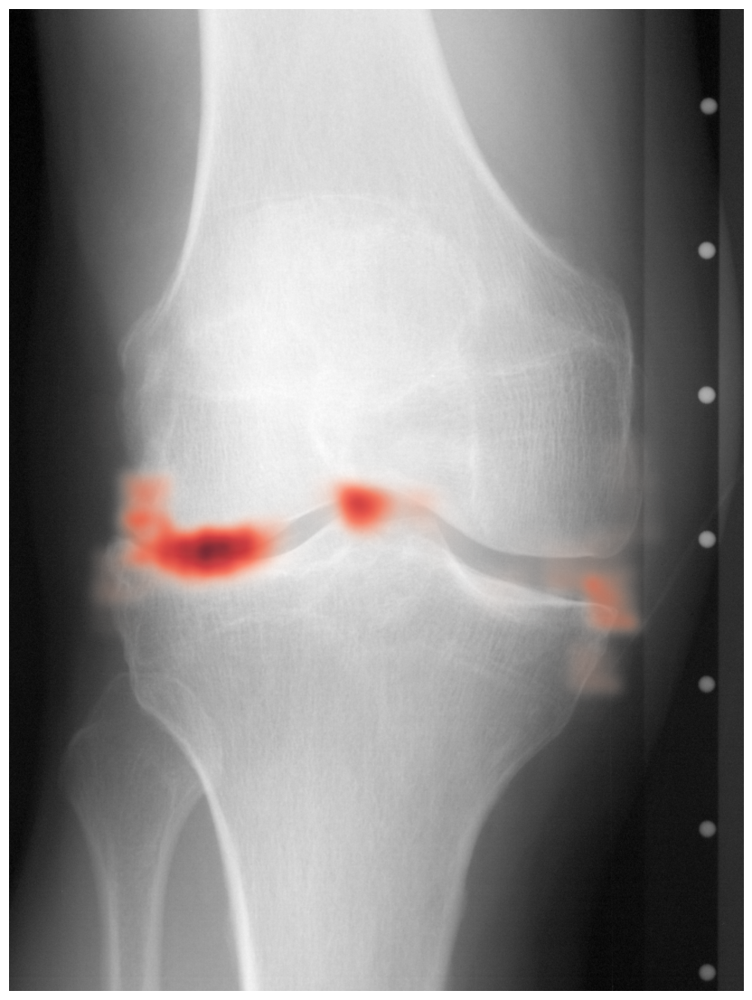

In [29]:
# --- Setup for Multi-Subplot Figure ---
cam_data_sources_to_plot = { # Changed variable name to avoid conflict
    "Ensemble": ensemble_grayscale_cams
} 

num_methods = len(cam_data_sources_to_plot)
N_COLS_SUBPLOT = 1
N_ROWS_SUBPLOT = math.ceil(num_methods / N_COLS_SUBPLOT)

TOTAL_FIG_WIDTH = SUBPLOT_FIG_WIDTH * N_COLS_SUBPLOT
TOTAL_FIG_HEIGHT = SUBPLOT_FIG_HEIGHT * N_ROWS_SUBPLOT

fig, axes_array = plt.subplots(N_ROWS_SUBPLOT, N_COLS_SUBPLOT, figsize=(TOTAL_FIG_WIDTH, TOTAL_FIG_HEIGHT))

if num_methods == 0:
    print("No CAM data to plot.")
    # plt.show() # Or handle as an error
    # exit() # Or return, depending on context
else:
    if num_methods == 1:
        axes_list = [axes_array]
    elif N_ROWS_SUBPLOT == 1 or N_COLS_SUBPLOT == 1:
        axes_list = axes_array.flatten() if isinstance(axes_array, np.ndarray) else [axes_array]
    else:
        axes_list = axes_array.flatten()


    # fig.suptitle(f"{dicom_info.SeriesDescription} - CAM Method Comparison:\n{current_patient_id}_{side} [{index_test}] (True: KL-{test_kls[index_test]}, Pred: KL-{test_preds[index_test].argmax()})", 
    #              fontsize=30, y=0.99)

    for i, (method_name, cam_array_for_method) in enumerate(cam_data_sources_to_plot.items()):
        if i < len(axes_list):
            current_ax = axes_list[i]
            print(f"Plotting: {method_name} on subplot {i+1}")
            
            test_map = plot_heatmaps_on_ax(
                ax=current_ax,
                dicom_data=dicom_info,
                base_image=base_image_processed,
                shapes_L_current=current_shapes_L,
                shapes_R_current=current_shapes_R,
                patch_point_indices=PATCH_POINT_INDICES,
                current_grayscale_cams=cam_array_for_method,
                current_att_scores=att_scores,
                patch_half_size_val=patch_size_val, # This is the "half dimension"
                patch_dims_tuple_val=new_size_tuple_val, # This is (width, height)
                cmap_obj=CMAP,
                base_alpha_val=ALPHA,
                target_side_focus=side,
                patch_from_point_func=patchFromPoint,
                method_name=""
            )
        else:
            print(f"Warning: Not enough subplots for method {method_name}.")

    for j in range(num_methods, N_ROWS_SUBPLOT * N_COLS_SUBPLOT):
        if j < len(axes_list):
            fig.delaxes(axes_list[j])

    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    OUTPUT_DIR = rf".\demo" # Changed output dir name
    if not os.path.exists(OUTPUT_DIR):
        os.makedirs(OUTPUT_DIR)
        print(f"Created directory: {OUTPUT_DIR}")
    
    save_filename = f"{current_patient_id}_{side}_ecam.png"
    save_path = os.path.join(OUTPUT_DIR, save_filename)

    try:
        fig.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")
    except Exception as e:
        print(f"Error saving figure: {e}")

    plt.show()

# For paper

## original image

Figure saved to: .\demo\9932578_R_original.jpg


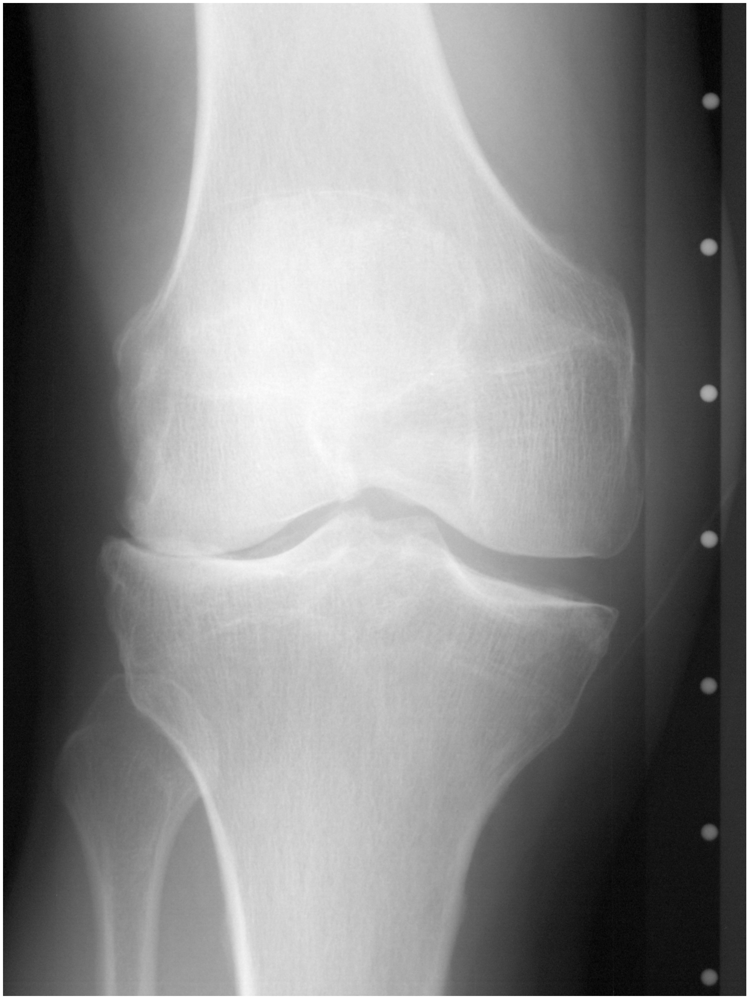

In [30]:
# 建立 colormap 與正規化函式
file_path = rf".\inference\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index_all]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
# 開圖
fig, ax = plt.subplots(figsize=(35, 43))
# ax.set_title(f"{dicom_data.SeriesDescription} ({patient_ids[index_all]})")

hh, ww = image.shape
target_side_focus = side
if target_side_focus == "L":
    w_max, h_max = np.max(shapes_L_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_L_2d[index_all], 0) - 2 * new_size_tuple_val[0]
else:
    w_max, h_max = np.max(shapes_R_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_R_2d[index_all], 0) - 2 * new_size_tuple_val[0] 

ax.imshow(image, cmap='gray', origin='upper', extent=(0, ww, hh, 0), zorder=0)
ax.set_xlim(w_min, w_max)
ax.set_ylim(h_max, h_min) # Inverted y-axis to match image coordinates (0,0 at top-left)
ax.axis('off')


OUTPUT_DIR = rf".\demo" # Changed output dir name
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)
    print(f"Created directory: {OUTPUT_DIR}")

save_filename = f"{current_patient_id}_{side}_original.jpg"
save_path = os.path.join(OUTPUT_DIR, save_filename)

try:
    fig.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Figure saved to: {save_path}")
except Exception as e:
    print(f"Error saving figure: {e}")


plt.show()


## w/ landmark

Figure saved to: .\demo\9932578_R_with_landmark.jpg


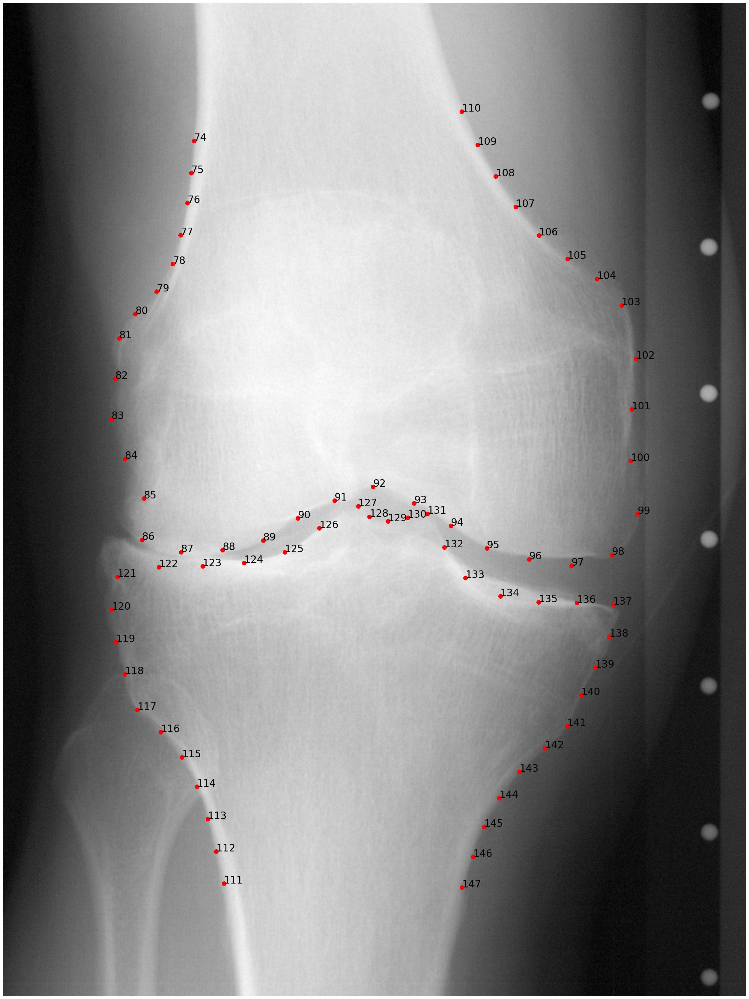

In [31]:
# 建立 colormap 與正規化函式
cmap = plt.get_cmap('Reds')

file_path = rf".\inference\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index_all]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
# 開圖
fig, ax = plt.subplots(figsize=(35, 43))
# ax.set_title(f"{dicom_data.SeriesDescription} ({patient_ids[index_all]})")

hh, ww = image.shape
target_side_focus = side
if target_side_focus == "L":
    w_max, h_max = np.max(shapes_L_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_L_2d[index_all], 0) - 2 * new_size_tuple_val[0]
else:
    w_max, h_max = np.max(shapes_R_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_R_2d[index_all], 0) - 2 * new_size_tuple_val[0] 

ax.imshow(image, cmap='gray', origin='upper', extent=(0, ww, hh, 0), zorder=0)
ax.set_xlim(w_min, w_max)
ax.set_ylim(h_max, h_min) # Inverted y-axis to match image coordinates (0,0 at top-left)
ax.axis('off')

ax.scatter(shapes_L_2d[index_all][:,0], shapes_L_2d[index_all][:,1], c='red', s=100)
ax.scatter(shapes_R_2d[index_all][:,0], shapes_R_2d[index_all][:,1], c='red', s=100)
for i_pt in range(len(shapes_L_2d[index_all])):
    ax.annotate(str(i_pt), shapes_L_2d[index_all][i_pt], color='black', fontsize=24)
    ax.annotate(str(i_pt+len(shapes_L_2d[index_all])),
                shapes_R_2d[index_all][i_pt], color='black', fontsize=24)

OUTPUT_DIR = rf".\demo" # Changed output dir name
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)
    print(f"Created directory: {OUTPUT_DIR}")

save_filename = f"{current_patient_id}_{side}_with_landmark.jpg"
save_path = os.path.join(OUTPUT_DIR, save_filename)

try:
    fig.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Figure saved to: {save_path}")
except Exception as e:
    print(f"Error saving figure: {e}")

plt.show()


## w/ landmark and patch 

Figure saved to: .\demo\9932578_R_with_landmark_patch.jpg


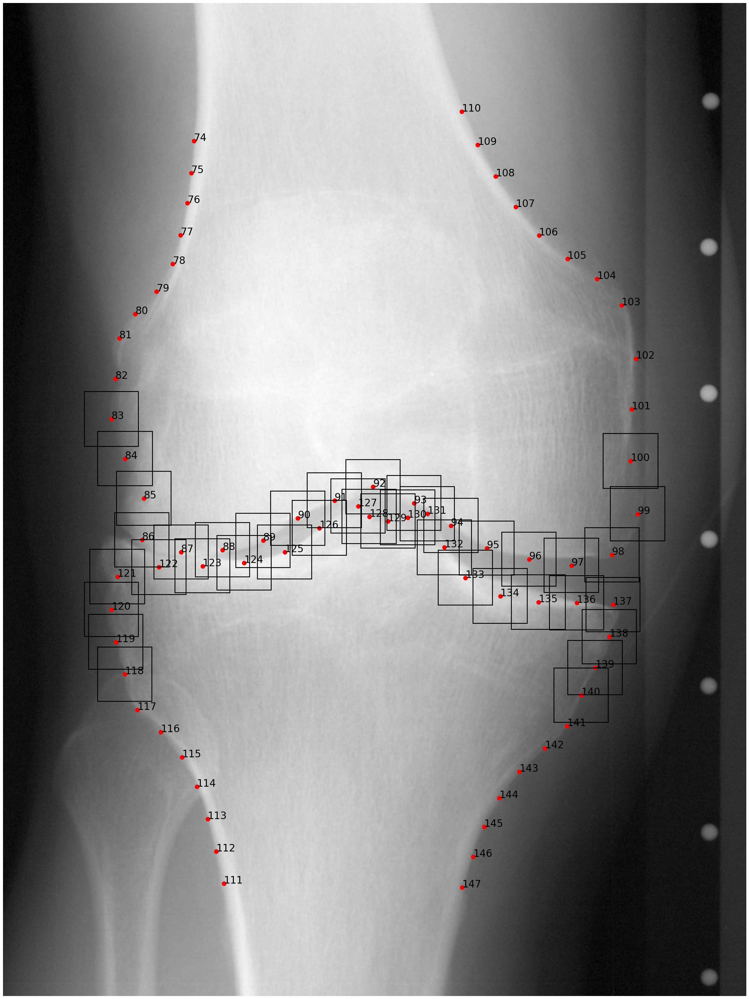

In [32]:
# 建立 colormap 與正規化函式
cmap = plt.get_cmap('Reds')

file_path = rf".\inference\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index_all]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
# 開圖
fig, ax = plt.subplots(figsize=(35, 43))
# ax.set_title(f"{dicom_data.SeriesDescription} ({patient_ids[index_all]})")

hh, ww = image.shape
target_side_focus = side
if target_side_focus == "L":
    w_max, h_max = np.max(shapes_L_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_L_2d[index_all], 0) - 2 * new_size_tuple_val[0]
else:
    w_max, h_max = np.max(shapes_R_2d[index_all], 0) + 2 * new_size_tuple_val[0]
    w_min, h_min = np.min(shapes_R_2d[index_all], 0) - 2 * new_size_tuple_val[0] 

ax.imshow(image, cmap='gray', origin='upper', extent=(0, ww, hh, 0), zorder=0)
ax.set_xlim(w_min, w_max)
ax.set_ylim(h_max, h_min) # Inverted y-axis to match image coordinates (0,0 at top-left)
ax.axis('off')

ax.scatter(shapes_L_2d[index_all][:,0], shapes_L_2d[index_all][:,1], c='red', s=100)
ax.scatter(shapes_R_2d[index_all][:,0], shapes_R_2d[index_all][:,1], c='red', s=100)
for i_pt in range(len(shapes_L_2d[index_all])):
    ax.annotate(str(i_pt), shapes_L_2d[index_all][i_pt], color='black', fontsize=24)
    ax.annotate(str(i_pt+len(shapes_L_2d[index_all])),
                shapes_R_2d[index_all][i_pt], color='black', fontsize=24)

# 用你原本的 PATCH_POINT_INDICES 和 patchFromPoint
range1 = np.arange(9, 27)
range2 = np.arange(44, 67)
PATCH_POINT_INDICES = np.concatenate([range1, range2])
for id, i in enumerate(PATCH_POINT_INDICES):
    # 左膝
    w = att_scores[id]
    rgba = cmap(w)
    topLeft, botRight = patchFromPoint(shapes_L_2d[index_all][i], size=size)
    if side == "L":
        rectL = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=2,
            edgecolor='black',
            facecolor='none',
        )
    else:
        rectL = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=2,
            edgecolor='black',
            facecolor='none',
        )
    ax.add_patch(rectL)

    # 右膝
    topLeft, botRight = patchFromPoint(shapes_R_2d[index_all][i], size=size)
    if side == "R":
        rectR = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=2,
            edgecolor='black',
            facecolor='none',
        )
    else:
        rectR = patches.Rectangle(
            (topLeft[0], topLeft[1]),
            botRight[0]-topLeft[0],
            botRight[1]-topLeft[1],
            linewidth=2,
            edgecolor='black',
            facecolor='none',
        )
    ax.add_patch(rectR)

OUTPUT_DIR = rf".\demo" # Changed output dir name
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)
    print(f"Created directory: {OUTPUT_DIR}")

save_filename = f"{current_patient_id}_{side}_with_landmark_patch.jpg"
save_path = os.path.join(OUTPUT_DIR, save_filename)

try:
    fig.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Figure saved to: {save_path}")
except Exception as e:
    print(f"Error saving figure: {e}")

plt.show()


## CAM comparison between Tiulpin's and ours

Figure saved to: .\demo\CAM_comparison\cam_comparison.pdf


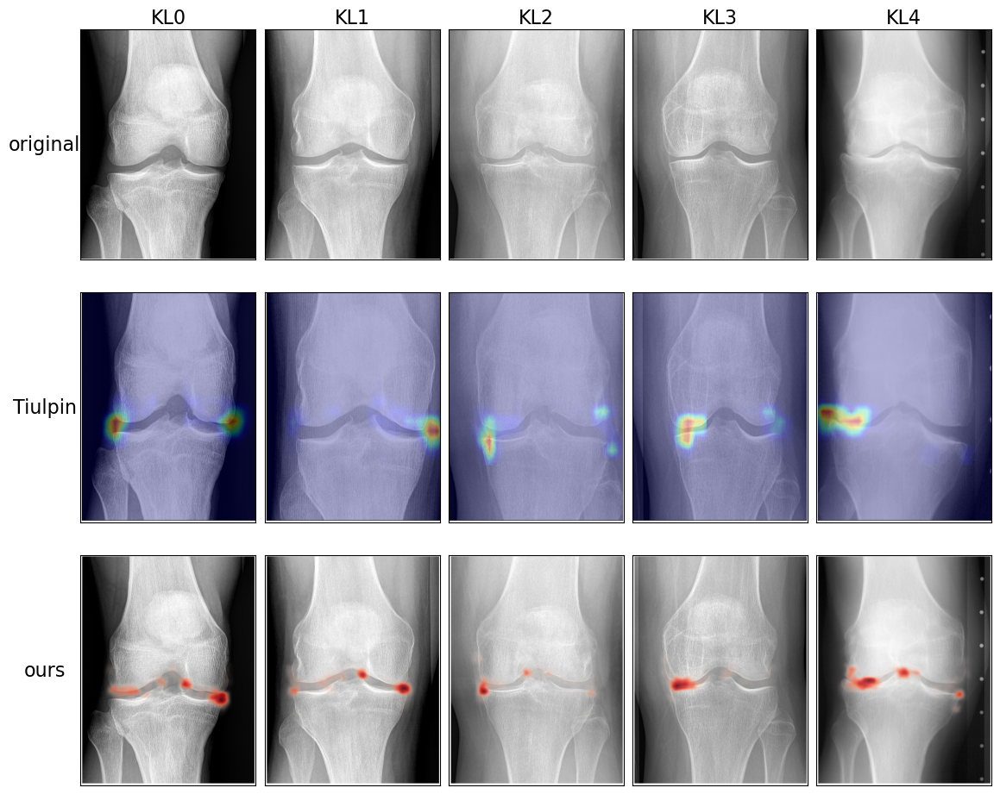

In [31]:
from PIL import Image

# 1. 設定 row 和 column 的名稱
row_names = ['original', 'Tiulpin', 'ours']
col_names = ['KL0', 'KL1', 'KL2', 'KL3', 'KL4']

# 2. 指定影像存放路徑
img_dir = r".\demo\CAM_comparison"

# 3. 先掃一遍所有圖檔，找出最大的 width, height
max_w, max_h = 0, 0
for row in row_names:
    for col in col_names:
        fpath = os.path.join(img_dir, f"{row}_{col}.png")
        if not os.path.exists(fpath):
            print(f"Warning: File not found, skipping: {fpath}")
            continue
        with Image.open(fpath) as im:
            w, h = im.size
        max_w = max(max_w, w)
        max_h = max(max_h, h)

# 4. 建立畫布
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(12, 10))

# Use subplots_adjust for precise manual control over spacing.
fig.subplots_adjust(left=0.1, right=0.98, bottom=0.02, top=0.92, wspace=0.05, hspace=0.05)


# 5. 讀圖、resize、繪製
for i, row in enumerate(row_names):
    for j, col in enumerate(col_names):
        ax = axes[i, j]
        fpath = os.path.join(img_dir, f"{row}_{col}.png")

        if not os.path.exists(fpath):
            ax.axis('off') # Can still use it here for blank plots
            continue

        img = Image.open(fpath).resize(
            (max_w, max_h),
            resample=Image.Resampling.LANCZOS
        )
        ax.imshow(img)

        # --- THE KEY CHANGE IS HERE ---
        # Instead of ax.axis('off()'), remove only the ticks and tick labels.
        # This keeps the axis "on" so it can have a label.
        ax.set_xticks([])
        ax.set_yticks([])
        # Optional: If you see a thin grey box, you can also turn off the spines
        # ax.spines[:].set_visible(False)


        # top row 加上 column title
        if i == 0:
            ax.set_title(col, fontsize=16, pad=5)

    # 左側第一欄加上 row label
    # Now this will work correctly because the axis is still active.
    axes[i, 0].set_ylabel(
        row,
        fontsize=16,
        rotation=0,
        va='center',
        labelpad=30
    )


OUTPUT_DIR = rf".\demo\CAM_comparison" # Changed output dir name
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)
    print(f"Created directory: {OUTPUT_DIR}")

save_filename = f"cam_comparison.pdf"
save_path = os.path.join(OUTPUT_DIR, save_filename)

try:
    fig.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Figure saved to: {save_path}")
except Exception as e:
    print(f"Error saving figure: {e}")

plt.show()
plt.show()